In [1]:
from mcbj import *

date = "21_12_03"
sample_rate = 50_000
home_folder = Path(f"D:/BJ_Data/{date}")

rcParams['figure.constrained_layout.use'] = False
rcParams['font.family'] = 'serif'
rcParams['font.serif'] = ['Times New Roman']
rcParams['mathtext.fontset'] = 'stix'
rcParams['mathtext.rm'] = 'serif'
rcParams['xtick.direction'] = 'in'
rcParams['ytick.direction'] = 'in'
rcParams['xtick.labelsize'] = 8
rcParams['ytick.labelsize'] = 8
rcParams['xtick.major.pad'] = 2
rcParams['xtick.minor.pad'] = 0.5
rcParams['ytick.major.pad'] = 1
rcParams['ytick.minor.pad'] = 0.5
rcParams['axes.labelsize'] = 8
rcParams['axes.titlepad'] = 6.0
rcParams['axes.labelpad'] = 2.0
rcParams['agg.path.chunksize'] = 10000

In [ ]:
noise_stat_1 = NoiseStats(home_folder, start_trace=5901, end_trace=26900, num_of_fft=1, min_step_len=None, bias_offset=0.0012,
                         save_data=1)

Processing hold files:   0%|          | 0/211 [00:00<?, ?it/s]D:\Greta\mcbj_stm-bj\mcbj.py:1596: RuntimeWarning: divide by zero encountered in true_divide
  multiplier = np.array([self.r0 ** 2 / bias_steps ** 2])
Processing hold files:  51%|█████     | 108/211 [25:15<34:30, 20.10s/it]

In [ ]:
noise_stat_2 = NoiseStats(home_folder, start_trace=33401, end_trace=39800, bias_offset=0.0012,
                          num_of_fft=1, min_step_len=None, save_data=2)

In [2]:
hist_1 = Histogram(home_folder, 1, 5900)

hist_1.calc_stats(align_at=1e-5, range_pull=(-1.5, 1), range_push=(-3, 1), xbins_pull=250, xbins_push=400,
                  plateau_length_bins=100)

Processing break junction files: 100%|██████████| 60/60 [14:19<00:00, 14.32s/it]

Pull 2D histogram created from 5894 traces
Push 2D histogram created from 5832 traces


(-1.0, 0.2)

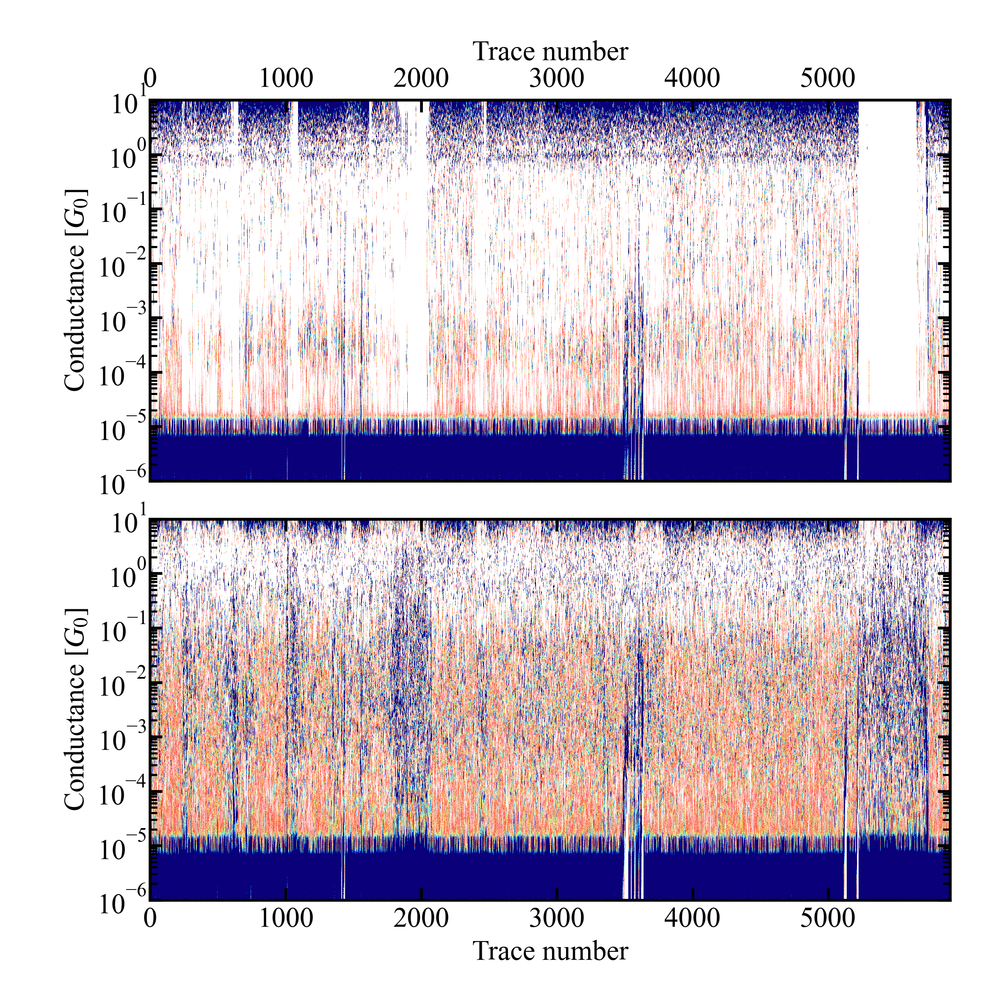

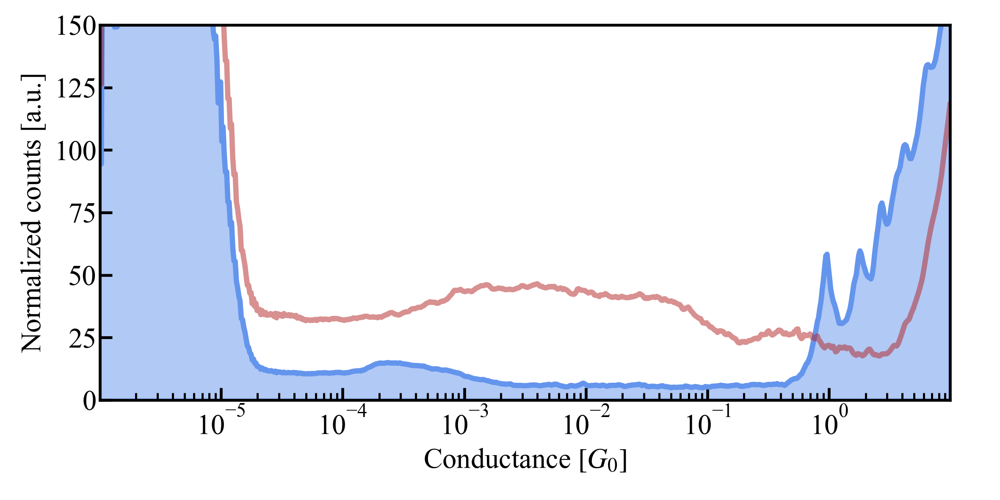

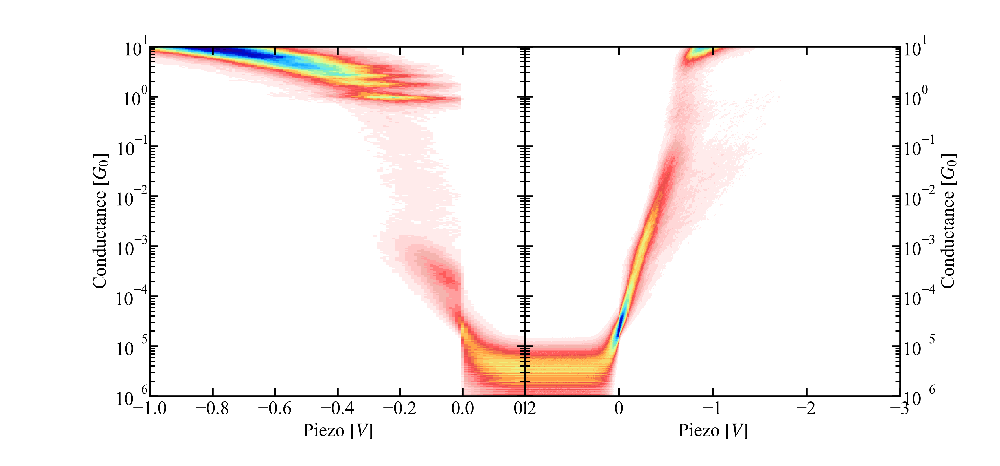

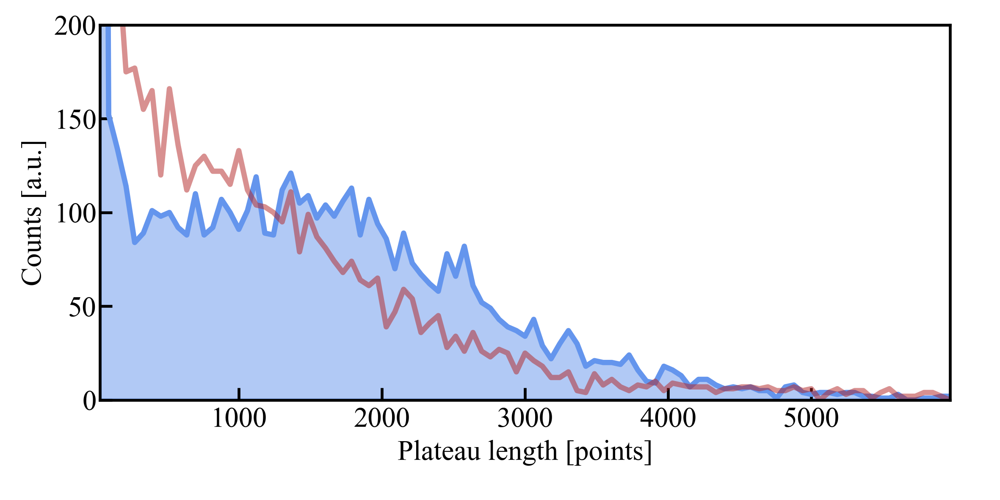

In [3]:
hist_1.plot_temporal_hist(vmax=100)
hist_1.plot_hist_1d(ylims=(0, 150))
ax_pull, ax_push = hist_1.plot_hist_2d_both(cmap=hist_1.cmap_geo32)
ax = hist_1.plot_plateau_length_hist()
ax.set_ylim(0, 200)
ax_pull.set_xlim(-1, 0.2)

In [4]:
hist_2 = Histogram(home_folder, 26901, 33400)

hist_2.calc_stats(align_at=1e-5, range_pull=(-1.5, 1), range_push=(-3, 1), xbins_pull=250, xbins_push=400,
                  plateau_length_bins=100)

Processing break junction files: 100%|██████████| 66/66 [16:09<00:00, 14.69s/it]

Pull 2D histogram created from 6500 traces
Push 2D histogram created from 6500 traces


<AxesSubplot:xlabel='Plateau length [points]', ylabel='Counts [a.u.]'>

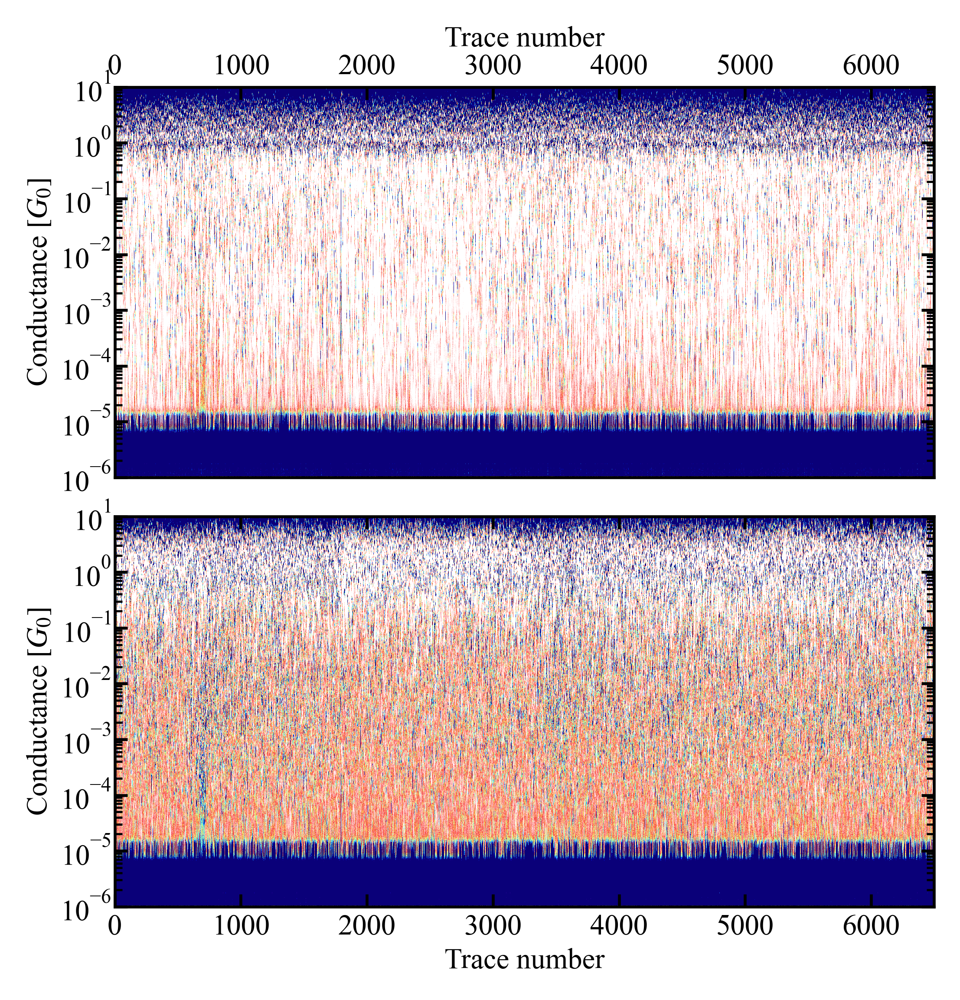

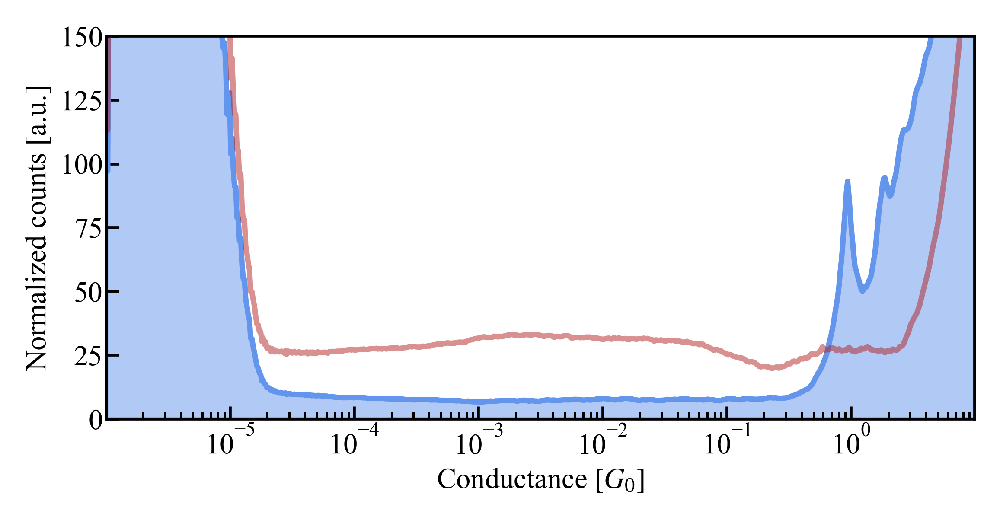

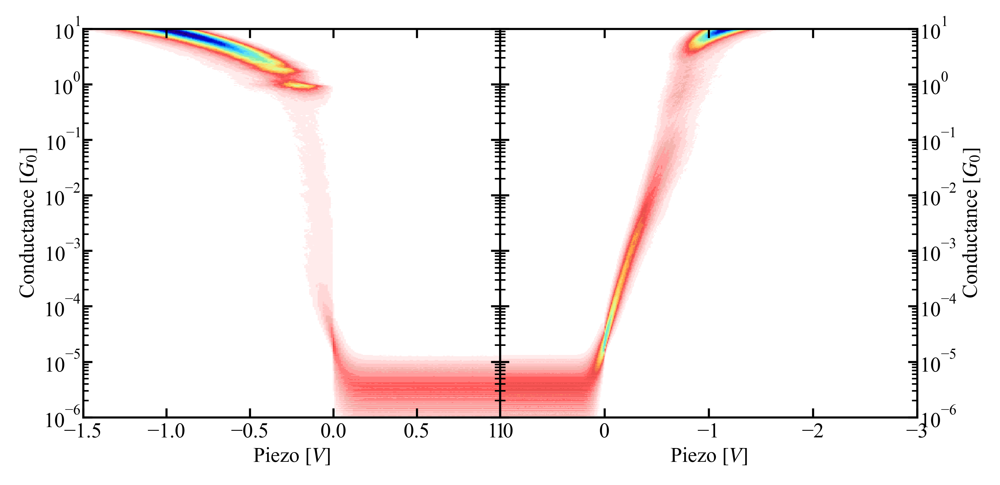

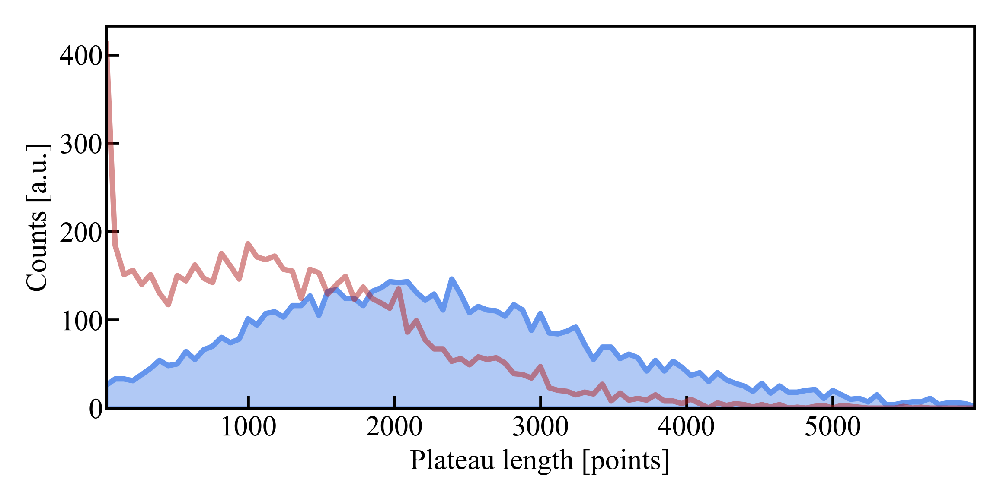

In [5]:
hist_2.plot_temporal_hist(vmax=100)
hist_2.plot_hist_1d(ylims=(0, 150))
hist_2.plot_hist_2d_both(cmap=hist_1.cmap_geo32)
hist_2.plot_plateau_length_hist()


In [2]:
hold_trace = HoldTrace(5909, load_from=home_folder, bias_offset=0.0012, min_step_len=None)
hold_trace.analyse_hold_trace(num_of_fft=1)

D:\Greta\mcbj_stm-bj\mcbj.py:1636: RuntimeWarning: divide by zero encountered in true_divide
  multiplier = np.array([self.r0 ** 2 / bias_steps ** 2])


In [26]:
hold_trace.time_axis_pull[hold_trace.bias_steps_ranges_pull[1, 0]]

1.01

bias_steps [0.         0.04998779 0.1000061 ]


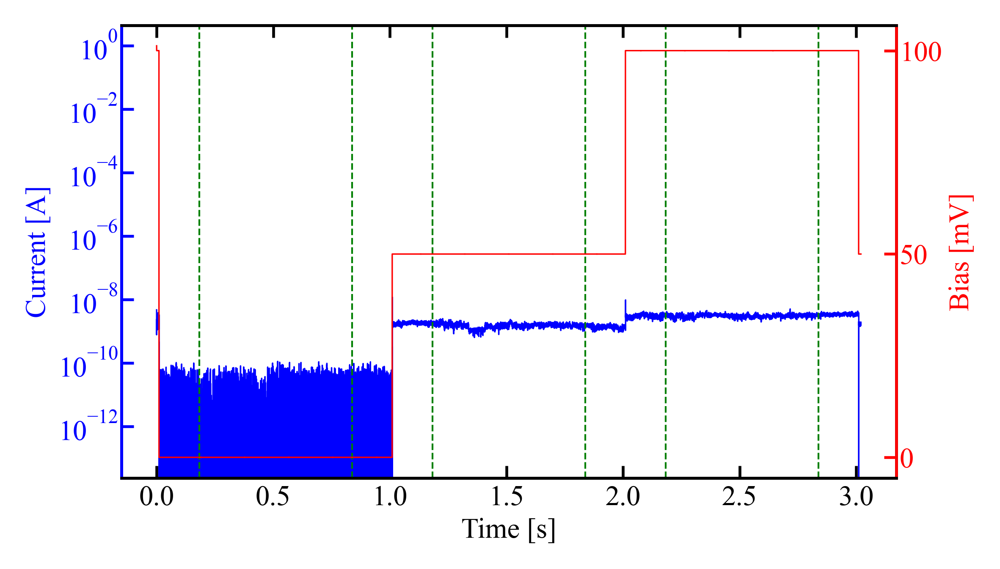

In [6]:
ax=hold_trace.plot_hold_traces(plot_step_ranges=False, plot_psd_intervals=True, conductance=False)
# ax.set_xlim(0.9, 1.1)
# ax.axvline(hold_trace.time_axis_pull[hold_trace.bias_steps_ranges_pull[1, 0]], lw=0.5, ls='--')

In [30]:
hold_trace.hold_conductance_pull[hold_trace.bias_steps_ranges_pull[1, 0]: hold_trace.bias_steps_ranges_pull[1, 0]+100]

array([-1.29000000e-01, -2.28556498e-06, -1.17350874e-05, -2.41354856e-05,
        8.10066336e-06, -2.00514900e-05, -1.73450874e-05, -9.32362186e-06,
       -1.66561644e-05, -2.20197134e-05,  1.55369892e-06, -1.71974605e-05,
       -1.07016136e-05, -1.75911268e-05, -1.30638152e-05, -1.22764240e-05,
       -5.58321205e-06, -2.05435525e-05, -2.54639572e-05, -2.72854213e-06,
       -5.63242896e-06, -1.06523999e-05, -1.87721118e-05, -3.12229737e-06,
       -2.78748196e-05, -3.56526889e-06, -2.21673264e-05,  3.71953830e-06,
       -3.25978767e-05, -2.08868515e-06, -9.02833442e-06, -9.12676370e-06,
       -2.50211357e-05, -5.09103657e-06, -2.60051788e-05,  7.55915932e-06,
       -4.15018731e-05,  1.82916213e-05, -5.60604531e-05,  4.28648488e-05,
       -9.05747545e-05,  8.15903691e-05, -1.52870032e-04,  3.14482121e-03,
        9.80036207e-04,  2.62864336e-04,  4.93187060e-04,  3.50401261e-04,
        4.52528910e-04,  3.61091834e-04,  4.47968836e-04,  3.98176119e-04,
        4.23389757e-04,  

In [5]:
noise_stat_1 = NoiseStats(home_folder, start_trace=5901, end_trace=26900, num_of_fft=1, bias_offset=0.0012, min_step_len=None)

Processing hold files:   0%|          | 0/211 [00:00<?, ?it/s]D:\Greta\mcbj_stm-bj\mcbj.py:1577: RuntimeWarning: divide by zero encountered in true_divide
  multiplier = np.array([self.r0 ** 2 / bias_steps ** 2])
Processing hold files: 100%|██████████| 211/211 [45:48<00:00, 13.03s/it]


In [9]:
hold_trace = HoldTrace(33401, load_from=home_folder, min_step_len=None)
hold_trace.analyse_hold_trace(num_of_fft=1)

bias_steps [-0.0012      0.04878779  0.09880611]


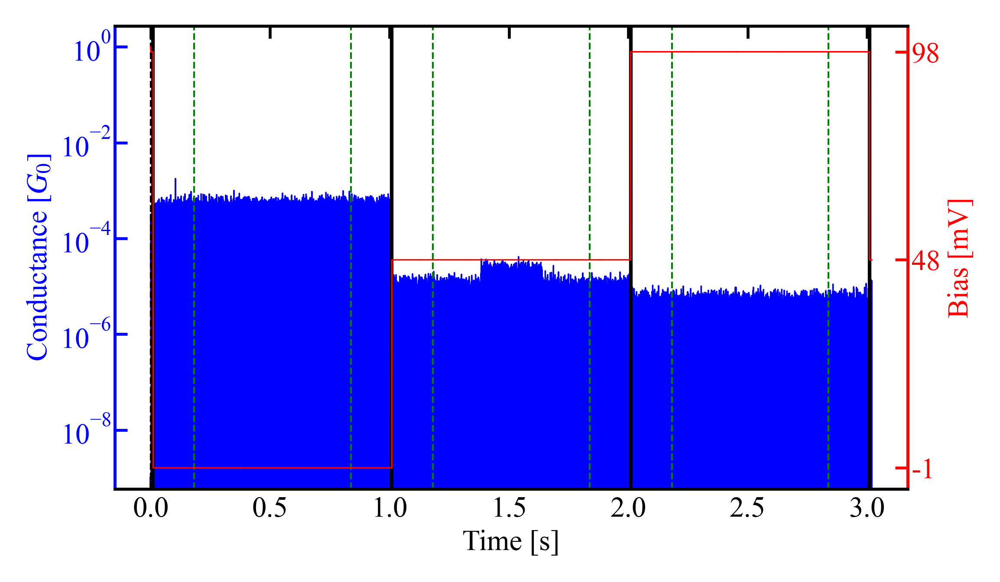

In [30]:
ax_hold = hold_trace.plot_hold_traces(plot_step_ranges=True, plot_psd_intervals=True, conductance=True,
                                      add_vlines=(0.001, 0.002))
# ax_hold.set_xlim(0, 0.01)

In [11]:
noise_stat_2 = NoiseStats(home_folder, start_trace=33401, end_trace=39700, num_of_fft=1, min_step_len=None)

Processing hold files: 100%|██████████| 64/64 [14:48<00:00, 13.88s/it]


In [12]:
import matplotlib.pyplot as plt

In [13]:
set_vals_pull, set_counts_pull = np.unique(noise_stat_1.G_set_pull, return_counts=True)
set_vals_push, set_counts_push = np.unique(noise_stat_1.G_set_push, return_counts=True)

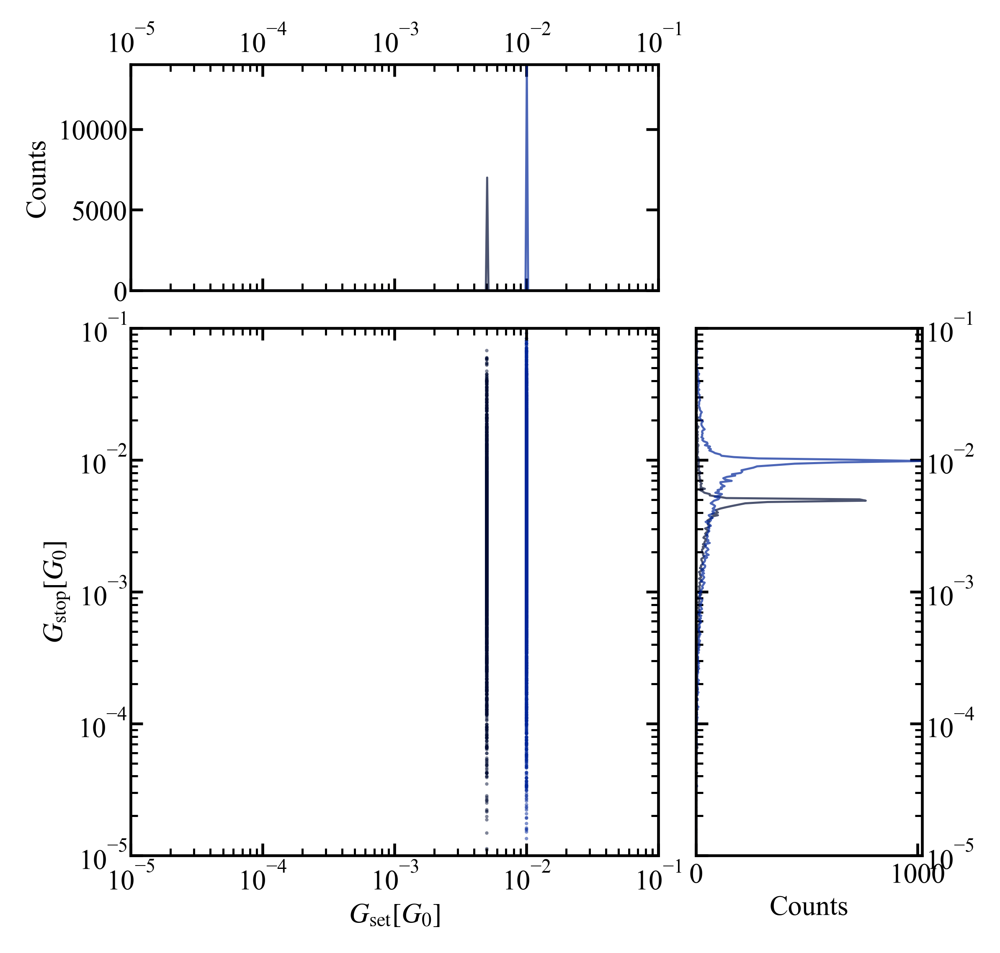

In [14]:
noise_stat_1.scat_and_hist(xlabel = r'$G_\mathrm{set} [G_{0}]$',
                           ylabel = r'$G_\mathrm{stop} [G_{0}]$',
                           x_pull = noise_stat_1.G_set_pull,
                           y_pull = noise_stat_1.G_stop_pull,
                           x_push = None,
                           y_push = None,
                           set_arr_pull = noise_stat_1.G_set_pull,
                           set_arr_push = None)

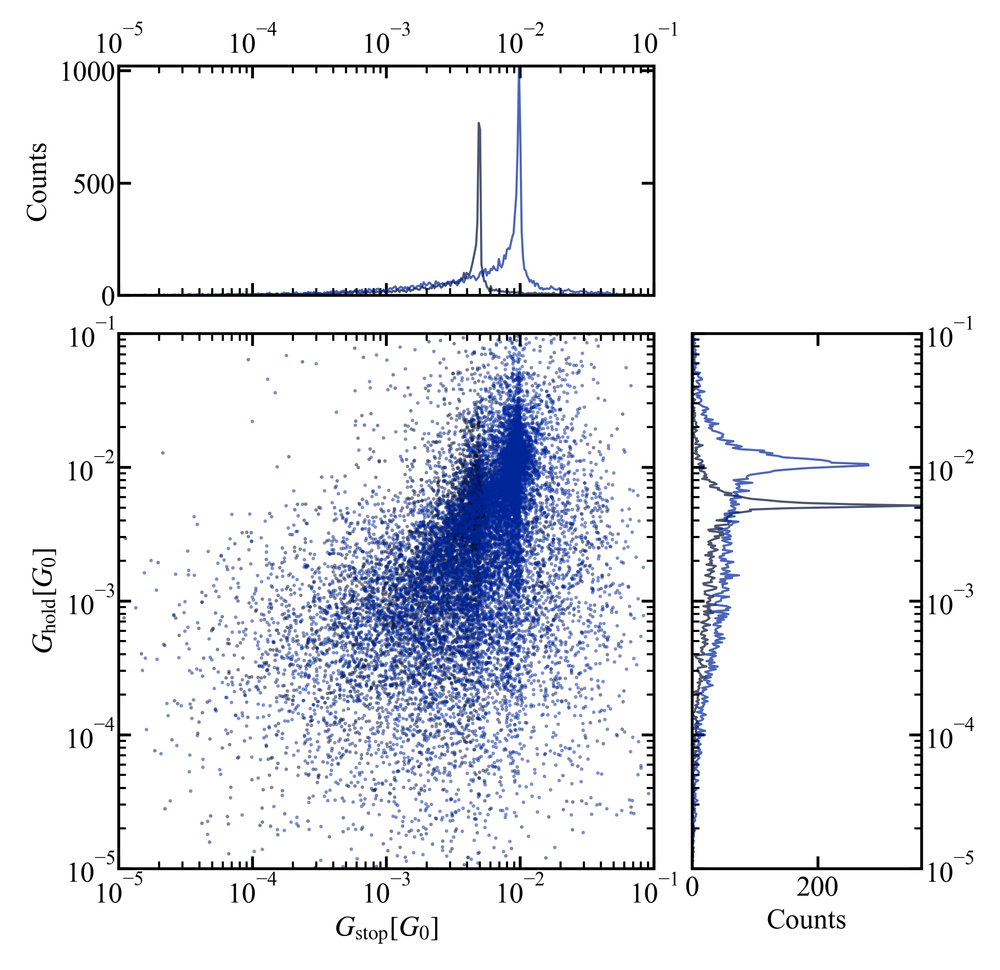

In [15]:
noise_stat_1.scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
                           ylabel = r'$G_\mathrm{hold} [G_{0}]$',
                           x_pull = noise_stat_1.G_stop_pull,
                           y_pull = noise_stat_1.G_hold_pull,
                           x_push = None,
                           y_push = None,
                           set_arr_pull = noise_stat_1.G_set_pull,
                           set_arr_push = None)

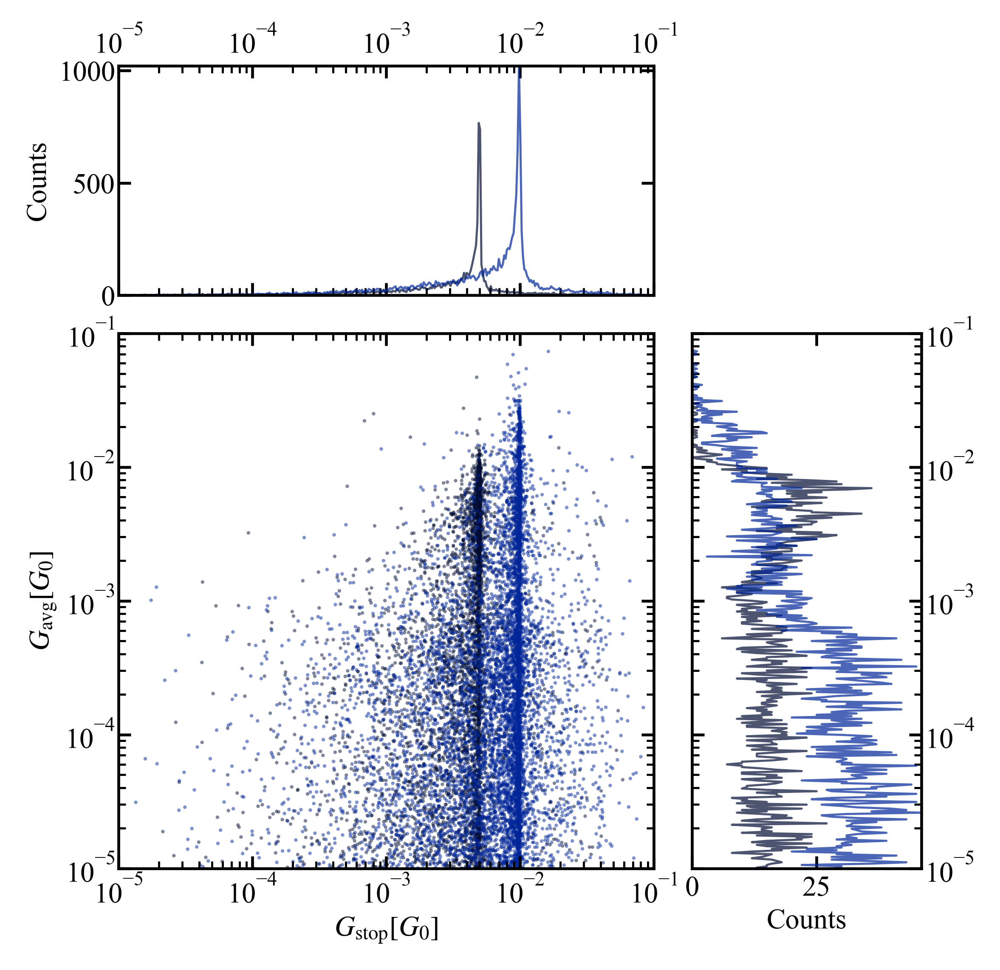

In [16]:
noise_stat_1.scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
                           ylabel = r'$G_\mathrm{avg} [G_{0}]$',
                           x_pull = noise_stat_1.G_stop_pull,
                           y_pull = noise_stat_1.G_avg_pull,
                           x_push = None,
                           y_push = None,
                           set_arr_pull = noise_stat_1.G_set_pull,
                           set_arr_push = None)

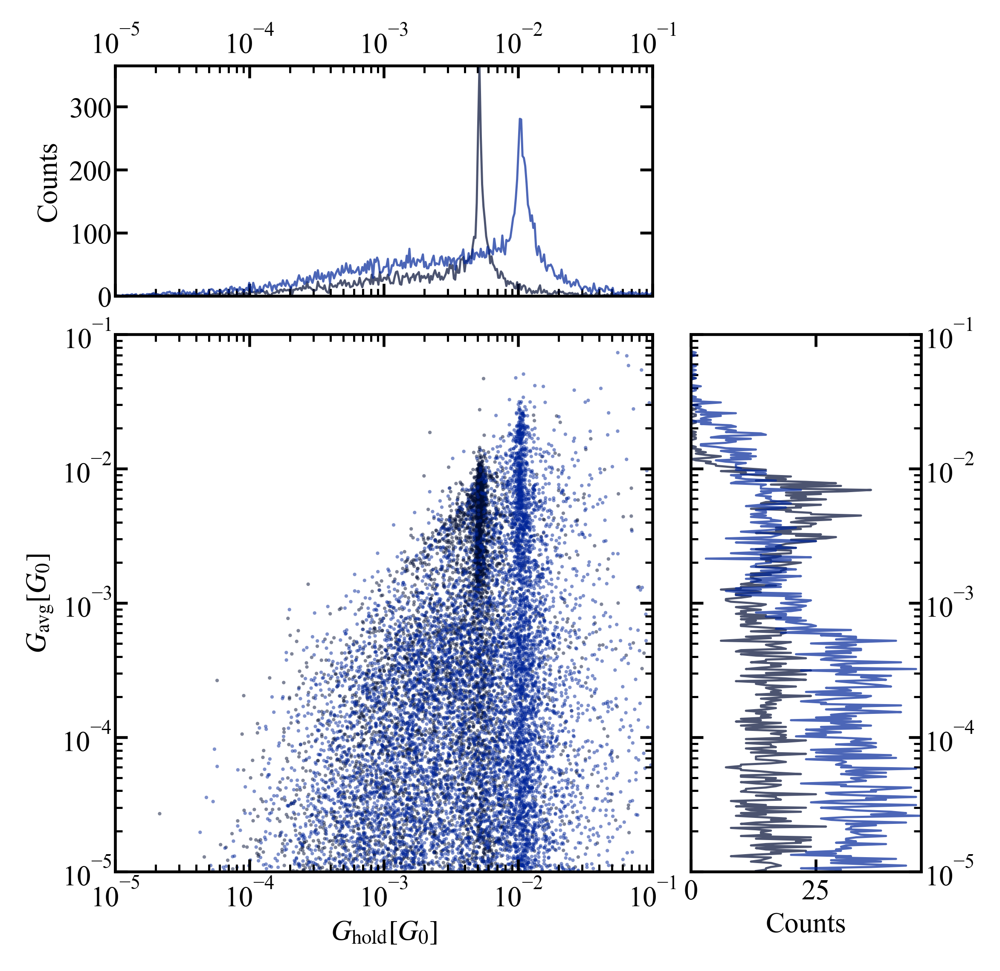

In [17]:
noise_stat_1.scat_and_hist(xlabel = r'$G_\mathrm{hold} [G_{0}]$',
                           ylabel = r'$G_\mathrm{avg} [G_{0}]$',
                           x_pull = noise_stat_1.G_hold_pull,
                           y_pull = noise_stat_1.G_avg_pull,
                           x_push = None,
                           y_push = None,
                           set_arr_pull = noise_stat_1.G_set_pull,
                           set_arr_push = None)

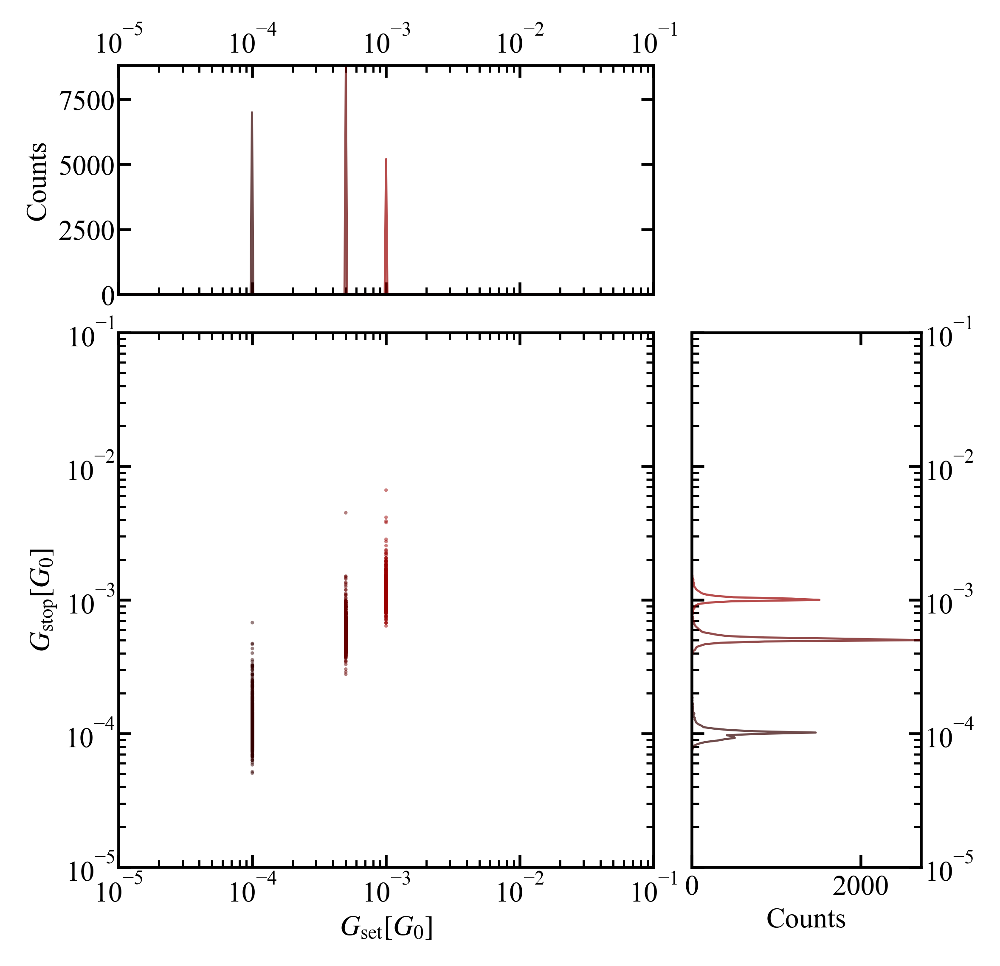

In [18]:
noise_stat_1.scat_and_hist(xlabel = r'$G_\mathrm{set} [G_{0}]$',
                           ylabel = r'$G_\mathrm{stop} [G_{0}]$',
                           x_pull = None,
                           y_pull = None,
                           x_push = noise_stat_1.G_set_push,
                           y_push = noise_stat_1.G_stop_push,
                           set_arr_pull = None,
                           set_arr_push = noise_stat_1.G_set_push)

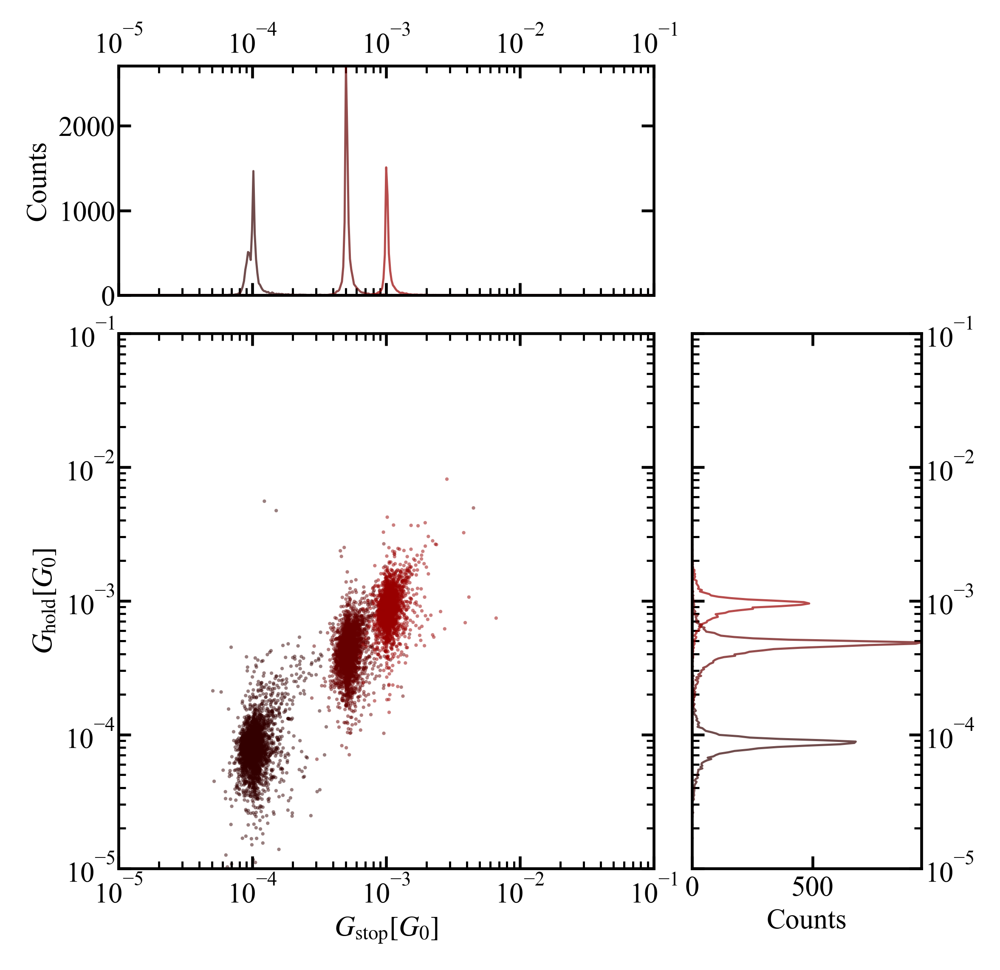

In [19]:
noise_stat_1.scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
                           ylabel = r'$G_\mathrm{hold} [G_{0}]$',
                           x_pull = None,
                           y_pull = None,
                           x_push = noise_stat_1.G_stop_push,
                           y_push = noise_stat_1.G_hold_push,
                           set_arr_pull = None,
                           set_arr_push = noise_stat_1.G_set_push)

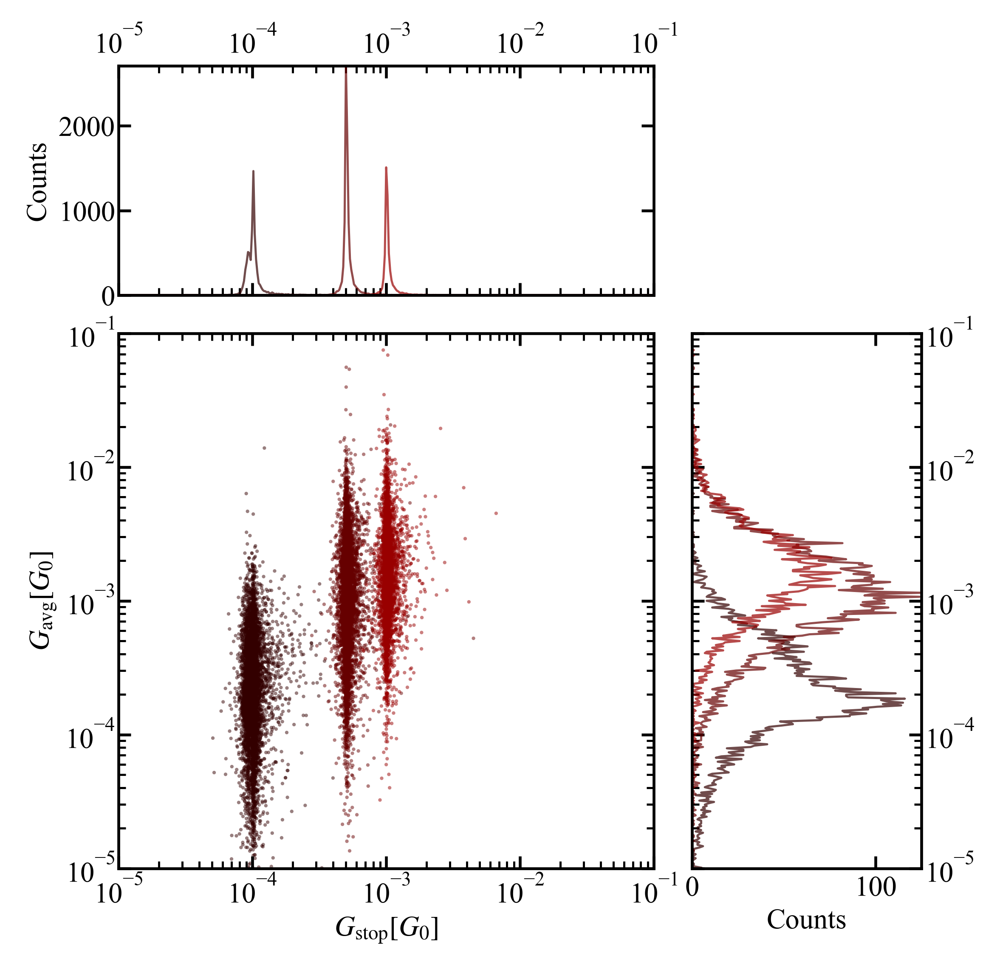

In [20]:
noise_stat_1.scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
                           ylabel = r'$G_\mathrm{avg} [G_{0}]$',
                           x_pull = None,
                           y_pull = None,
                           x_push = noise_stat_1.G_stop_push,
                           y_push = noise_stat_1.G_avg_push,
                           set_arr_pull = None,
                           set_arr_push = noise_stat_1.G_set_push)

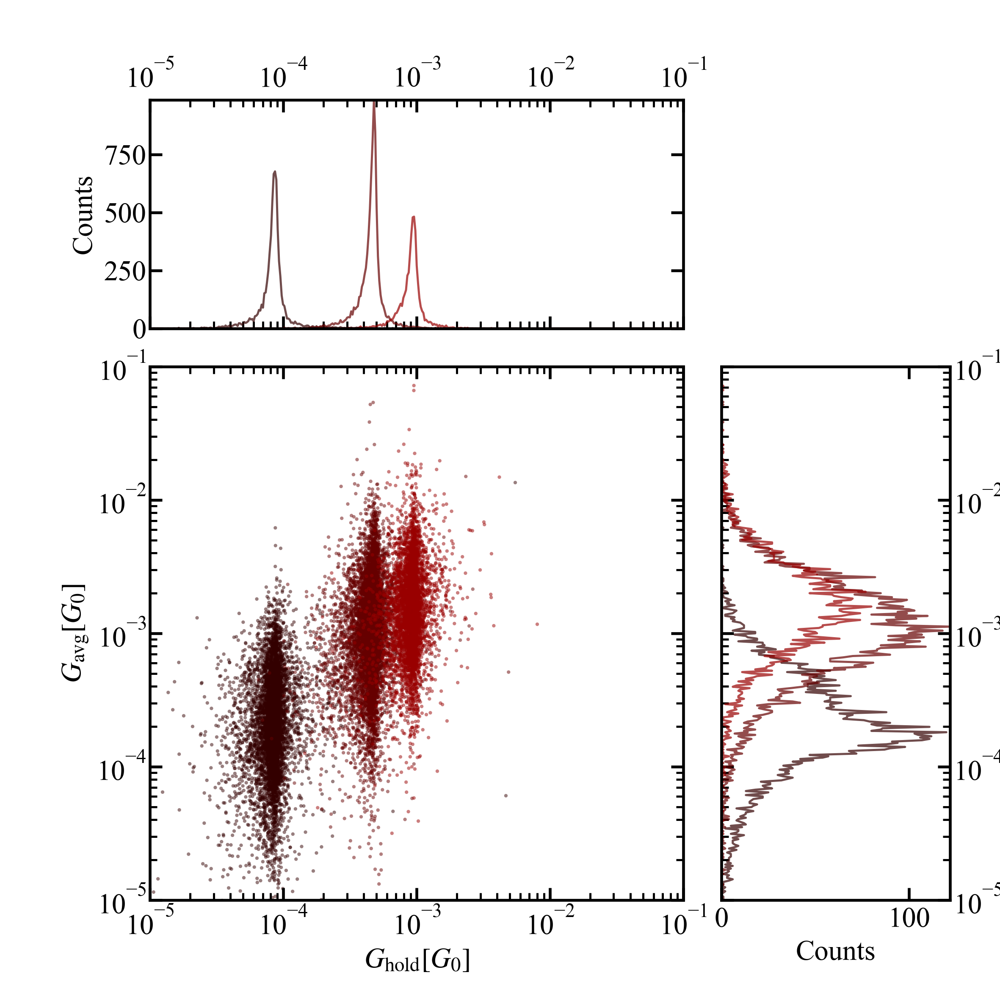

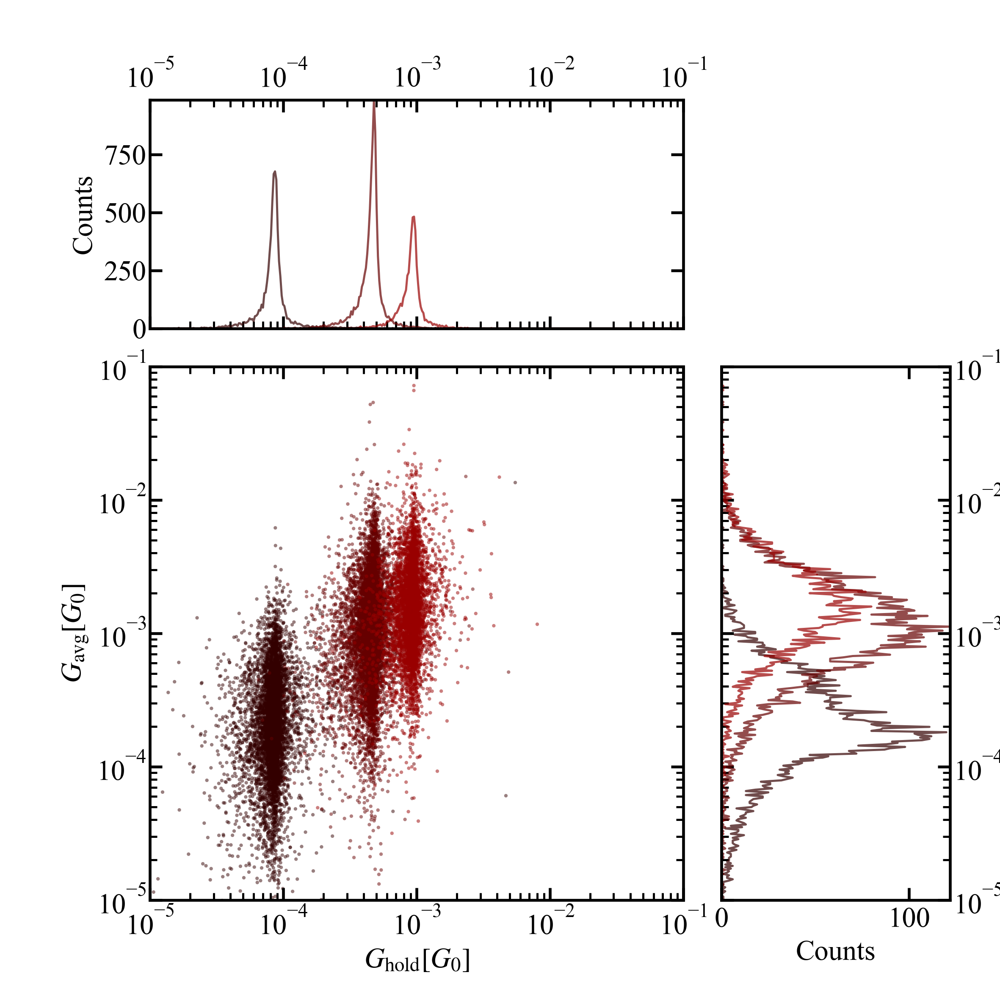

In [19]:
noise_stat_1.scat_and_hist(xlabel = r'$G_\mathrm{hold} [G_{0}]$',
                           ylabel = r'$G_\mathrm{avg} [G_{0}]$',
                           x_pull = None,
                           y_pull = None,
                           x_push = noise_stat_1.G_hold_push,
                           y_push = noise_stat_1.G_avg_push,
                           set_arr_pull = None,
                           set_arr_push = noise_stat_1.G_set_push)

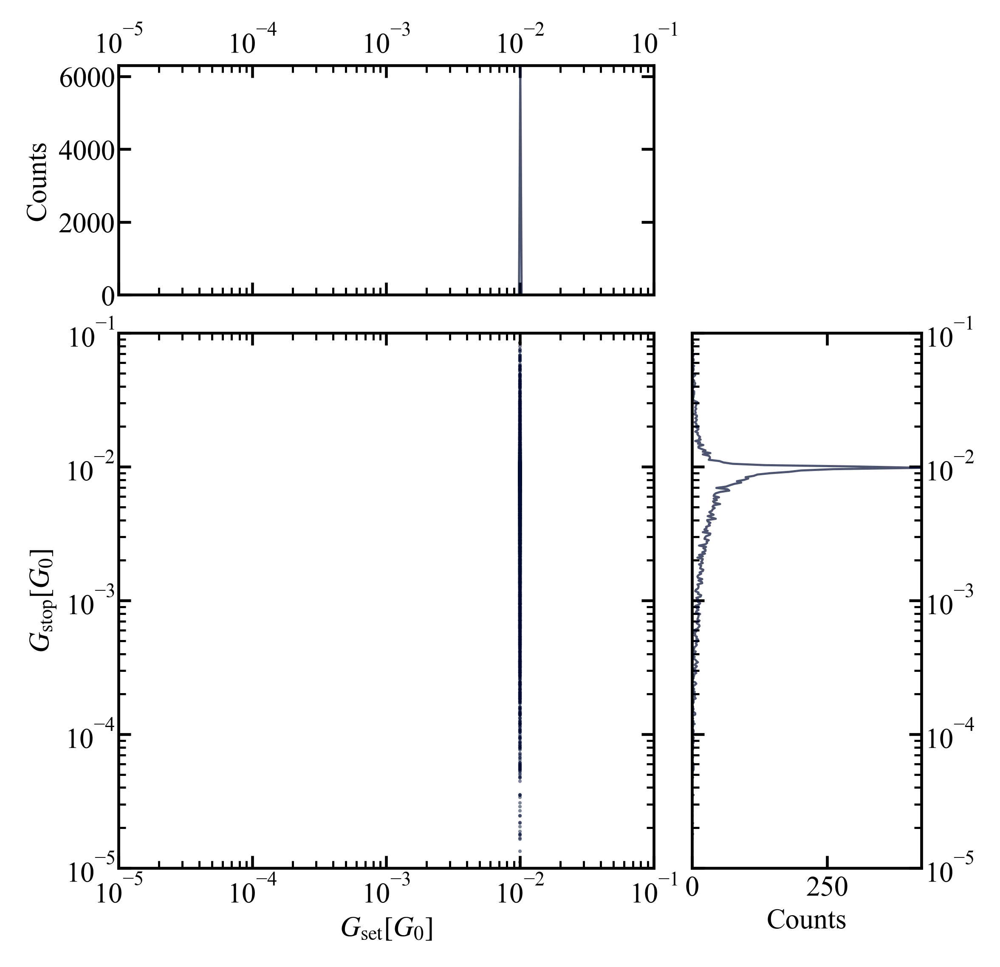

In [22]:
noise_stat_2.scat_and_hist(xlabel = r'$G_\mathrm{set} [G_{0}]$',
                           ylabel = r'$G_\mathrm{stop} [G_{0}]$',
                           x_pull = noise_stat_2.G_set_pull,
                           y_pull = noise_stat_2.G_stop_pull,
                           x_push = None,
                           y_push = None,
                           set_arr_pull = noise_stat_2.G_set_pull,
                           set_arr_push = None)

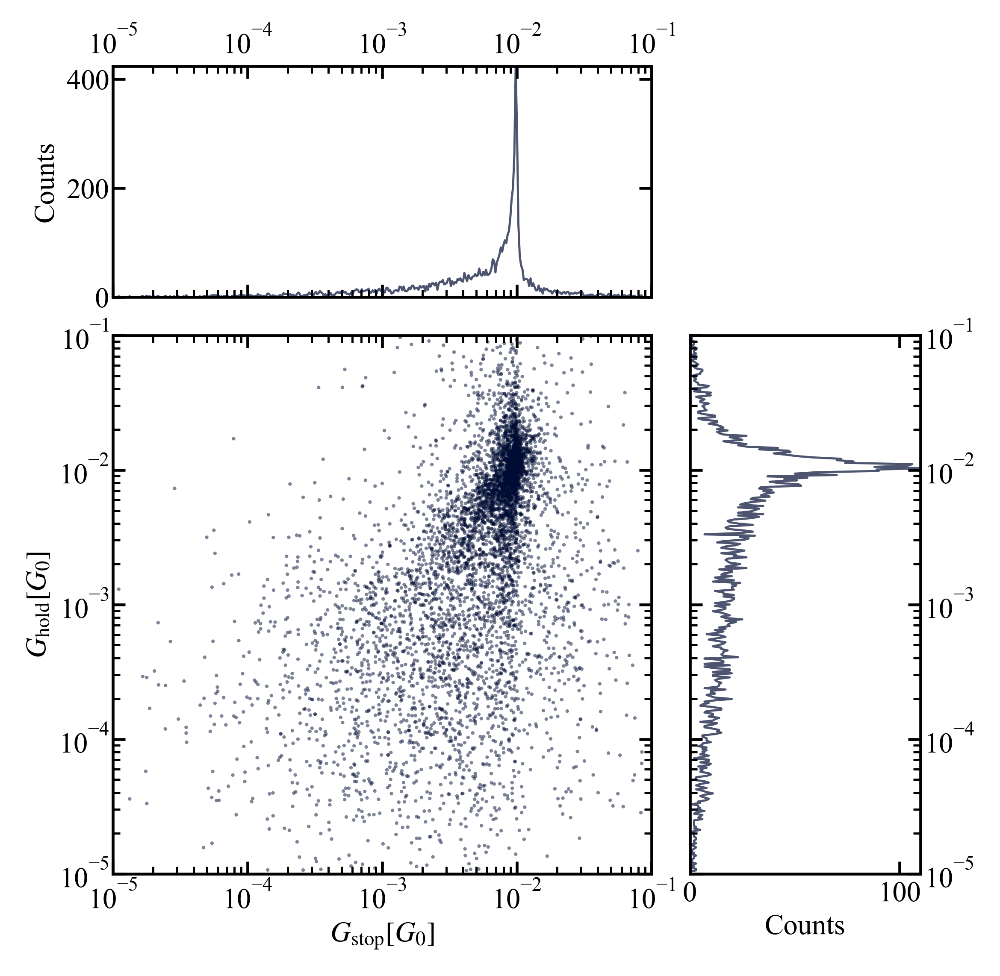

In [23]:
noise_stat_2.scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
                           ylabel = r'$G_\mathrm{hold} [G_{0}]$',
                           x_pull = noise_stat_2.G_stop_pull,
                           y_pull = noise_stat_2.G_hold_pull,
                           x_push = None,
                           y_push = None,
                           set_arr_pull = noise_stat_2.G_set_pull,
                           set_arr_push = None)

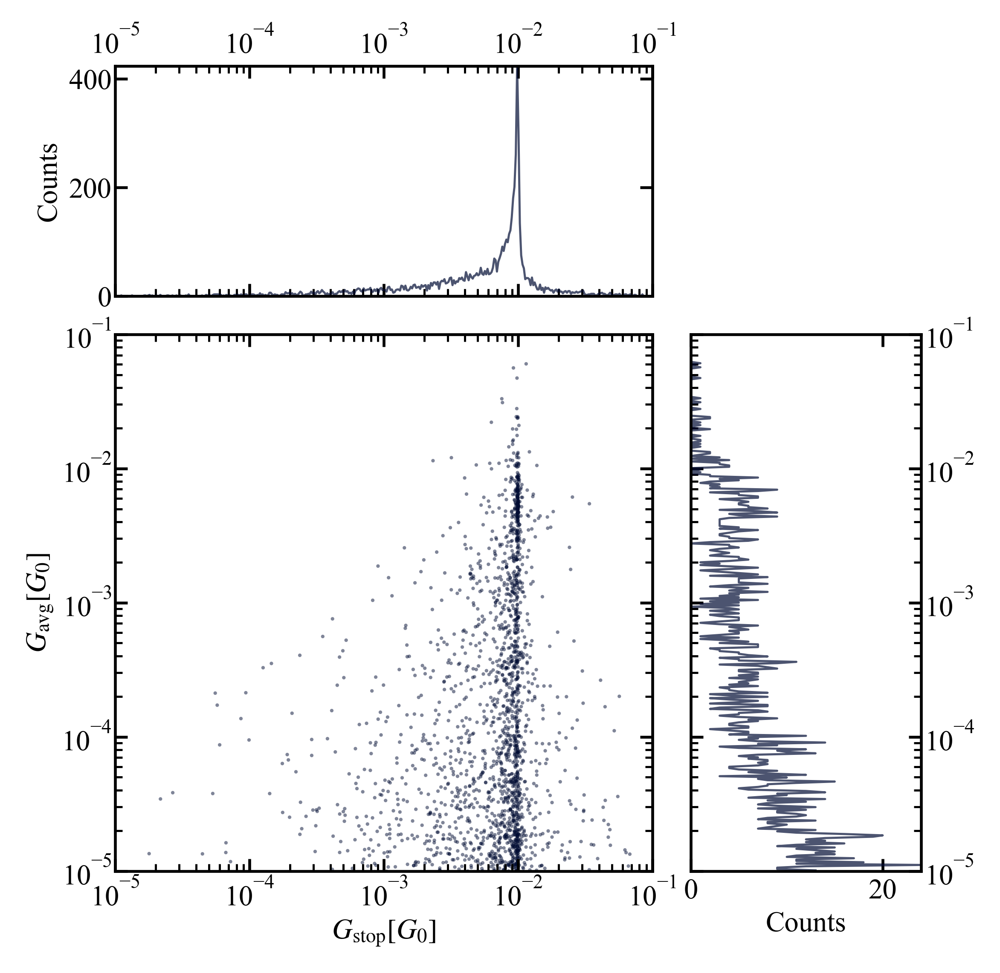

In [24]:
noise_stat_2.scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
                           ylabel = r'$G_\mathrm{avg} [G_{0}]$',
                           x_pull = noise_stat_2.G_stop_pull,
                           y_pull = noise_stat_2.G_avg_pull,
                           x_push = None,
                           y_push = None,
                           set_arr_pull = noise_stat_2.G_set_pull,
                           set_arr_push = None)

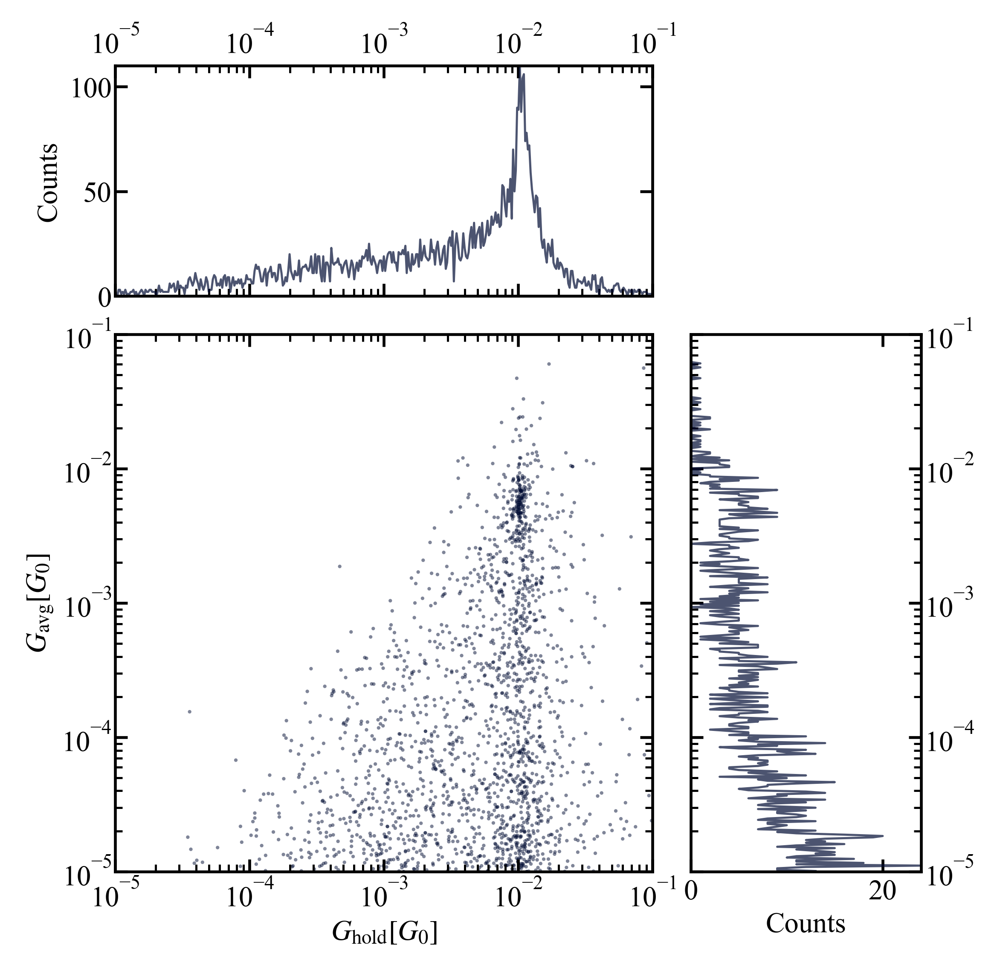

In [25]:
noise_stat_2.scat_and_hist(xlabel = r'$G_\mathrm{hold} [G_{0}]$',
                           ylabel = r'$G_\mathrm{avg} [G_{0}]$',
                           x_pull = noise_stat_2.G_hold_pull,
                           y_pull = noise_stat_2.G_avg_pull,
                           x_push = None,
                           y_push = None,
                           set_arr_pull = noise_stat_2.G_set_pull,
                           set_arr_push = None)

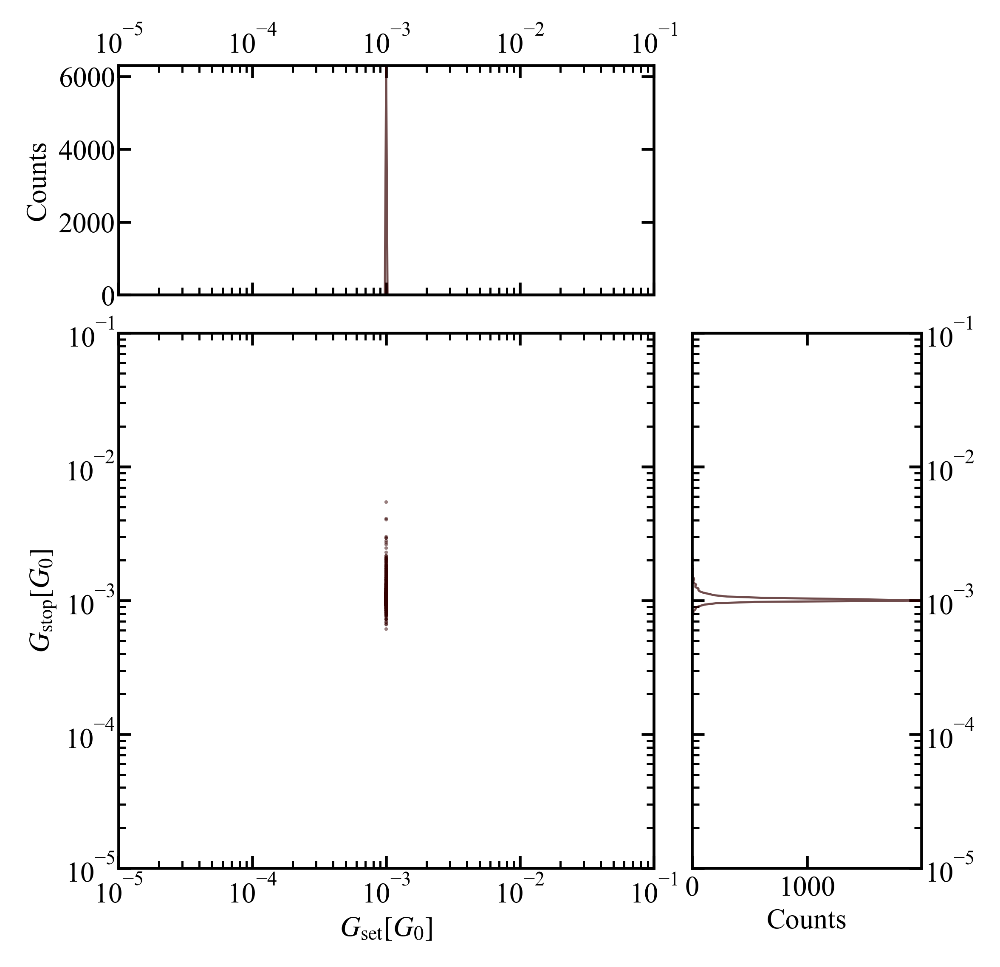

In [26]:
noise_stat_2.scat_and_hist(xlabel = r'$G_\mathrm{set} [G_{0}]$',
                           ylabel = r'$G_\mathrm{stop} [G_{0}]$',
                           x_pull = None,
                           y_pull = None,
                           x_push = noise_stat_2.G_set_push,
                           y_push = noise_stat_2.G_stop_push,
                           set_arr_pull = None,
                           set_arr_push = noise_stat_2.G_set_push)

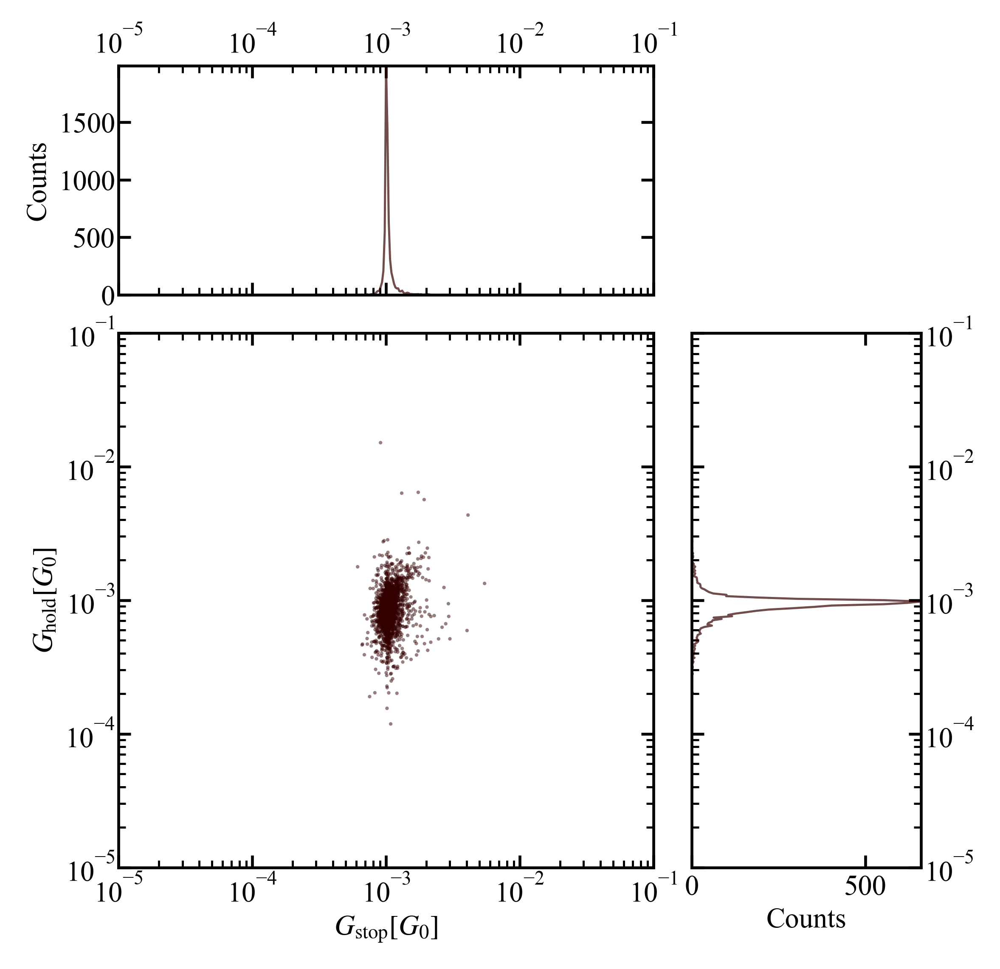

In [27]:
noise_stat_2.scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
                           ylabel = r'$G_\mathrm{hold} [G_{0}]$',
                           x_pull = None,
                           y_pull = None,
                           x_push = noise_stat_2.G_stop_push,
                           y_push = noise_stat_2.G_hold_push,
                           set_arr_pull = None,
                           set_arr_push = noise_stat_2.G_set_push)

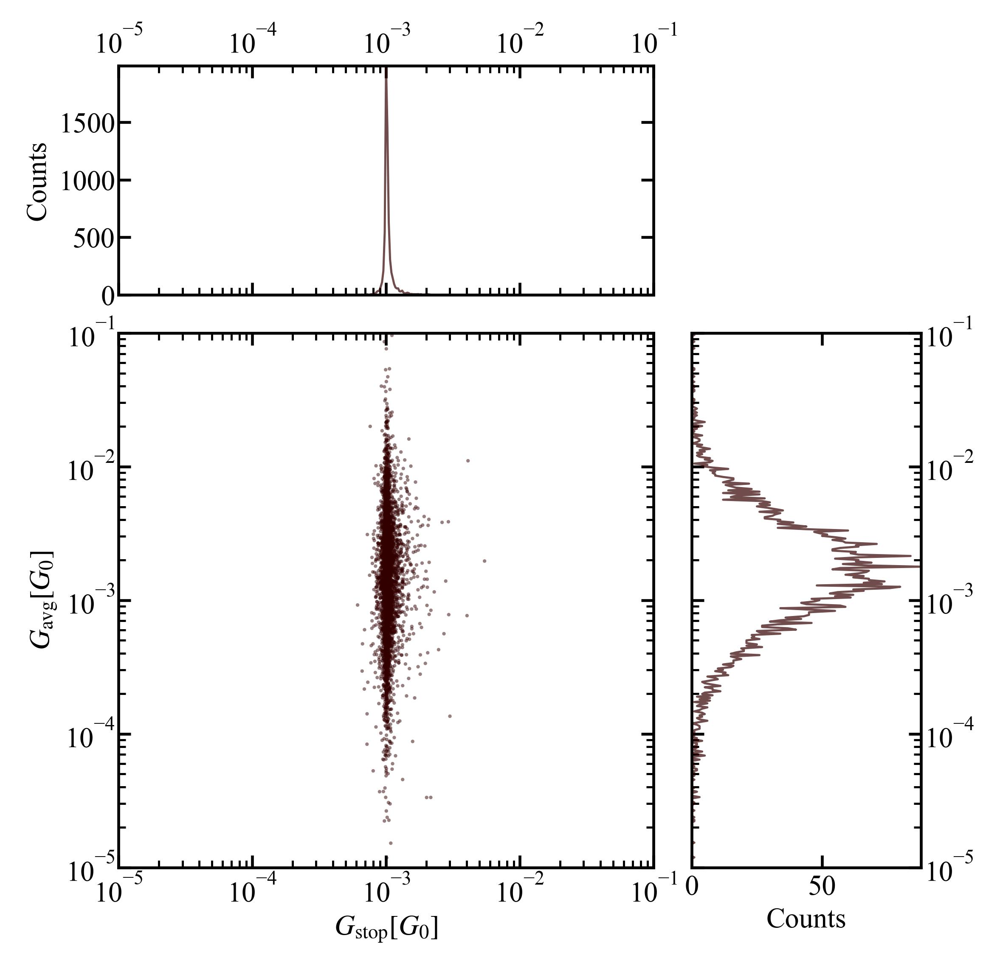

In [28]:
noise_stat_2.scat_and_hist(xlabel = r'$G_\mathrm{stop} [G_{0}]$',
                           ylabel = r'$G_\mathrm{avg} [G_{0}]$',
                           x_pull = None,
                           y_pull = None,
                           x_push = noise_stat_2.G_stop_push,
                           y_push = noise_stat_2.G_avg_push,
                           set_arr_pull = None,
                           set_arr_push = noise_stat_2.G_set_push)

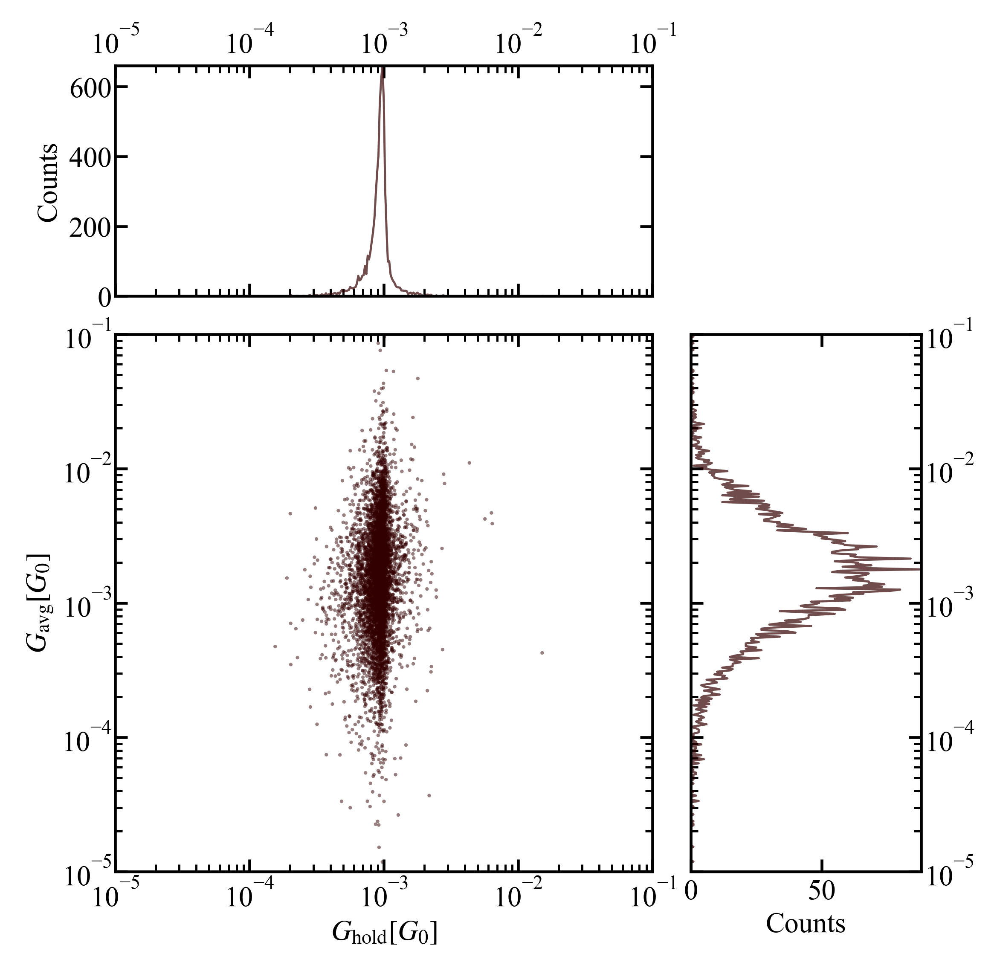

In [29]:
noise_stat_2.scat_and_hist(xlabel = r'$G_\mathrm{hold} [G_{0}]$',
                           ylabel = r'$G_\mathrm{avg} [G_{0}]$',
                           x_pull = None,
                           y_pull = None,
                           x_push = noise_stat_2.G_hold_push,
                           y_push = noise_stat_2.G_avg_push,
                           set_arr_pull = None,
                           set_arr_push = noise_stat_2.G_set_push)

In [9]:
noise_stat_1.noise_power_pull.shape[1]

3

C:\Users\ANDRS~1\AppData\Local\Temp/ipykernel_12452/2522010547.py:8: RuntimeWarning: invalid value encountered in power
  pull_corr[i] = utils.calc_correlation(np.log10(noise_stat_1.noise_power_pull[:, bias_step]/noise_stat_1.avg_cond_on_step_pull[:, bias_step]**n),
C:\Users\ANDRS~1\AppData\Local\Temp/ipykernel_12452/2522010547.py:9: RuntimeWarning: invalid value encountered in log10
  np.log10(noise_stat_1.avg_cond_on_step_pull[:, bias_step]))


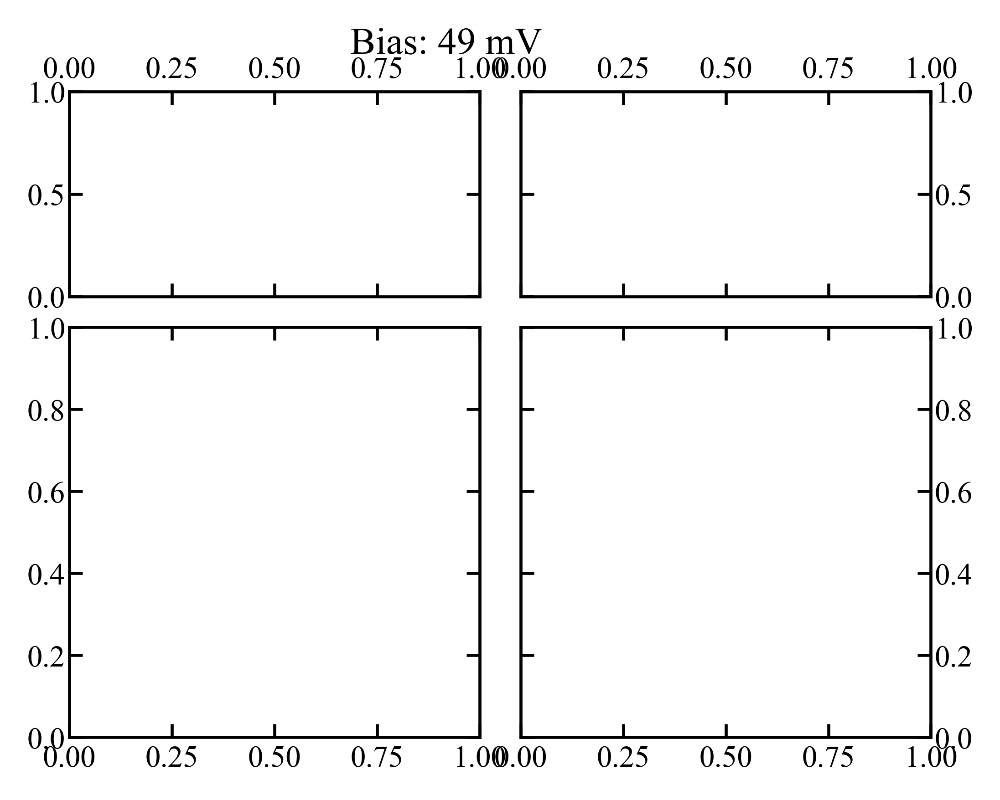

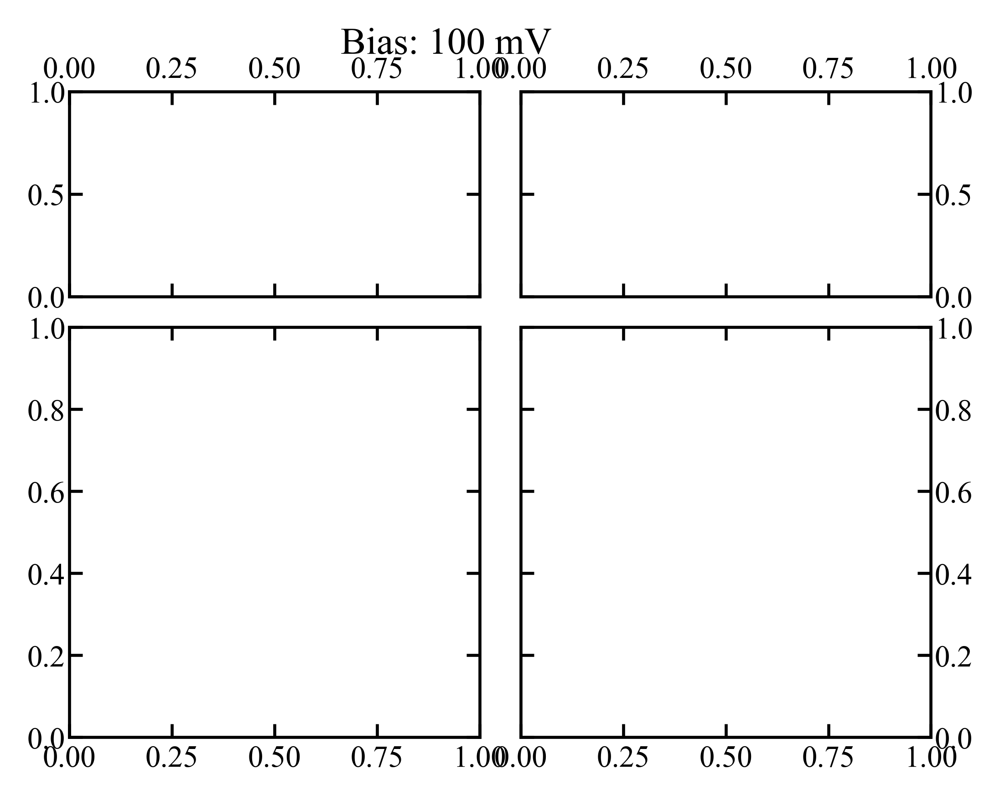

In [13]:
for bias_step in range(1, noise_stat_1.noise_power_pull.shape[1]):
    N = np.linspace(0.8, 2.2, num=1000)
    pull_corr = np.zeros_like(N)
    push_corr = np.zeros_like(N)

    for i, n in enumerate(N):

        pull_corr[i] = utils.calc_correlation(np.log10(noise_stat_1.noise_power_pull[:, bias_step]/noise_stat_1.avg_cond_on_step_pull[:, bias_step]**n),
                                                     np.log10(noise_stat_1.avg_cond_on_step_pull[:, bias_step]))
        push_corr[i] = utils.calc_correlation(np.log10(noise_stat_1.noise_power_push[:, bias_step]/noise_stat_1.avg_cond_on_step_push[:, bias_step]**n),
                                                     np.log10(noise_stat_1.avg_cond_on_step_push[:, bias_step])) 

    fig = plt.figure(figsize=utils.cm2inch(10, 7.5), dpi=600)  # figsize: (width, height) in inches
    gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(1, 1), height_ratios=(1, 2),
                           figure=fig, left=0.15, right=0.95, top=0.9, bottom=0.1, wspace=0.1, hspace=0.1)
    
    fig.suptitle(f'Bias: {int(hold_trace.bias_steps[bias_step]*1000)} mV', fontsize=10)
    
    ax_corr_pull = fig.add_subplot(gs[0, 0])
    ax_corr_push = fig.add_subplot(gs[0, 1])
    ax_corrhist_pull = fig.add_subplot(gs[1, 0])
    ax_corrhist_push = fig.add_subplot(gs[1, 1], sharey=ax_corrhist_pull)

    ax_corr_pull.xaxis.set_label_position('top')
    ax_corr_pull.xaxis.tick_top()
    ax_corr_pull.xaxis.set_ticks_position('both')
    ax_corr_pull.yaxis.set_label_position('left')
    ax_corr_pull.yaxis.set_ticks_position('both')

    ax_corr_push.xaxis.set_label_position('top')
    ax_corr_push.xaxis.tick_top()
    ax_corr_push.xaxis.set_ticks_position('both')
    ax_corr_push.yaxis.set_label_position('right')
    ax_corr_push.yaxis.tick_right()
    ax_corr_push.yaxis.set_ticks_position('both')

    ax_corrhist_pull.xaxis.set_label_position('bottom')
    ax_corrhist_pull.xaxis.set_ticks_position('both')
    ax_corrhist_pull.yaxis.set_label_position('left')
    ax_corrhist_pull.yaxis.set_ticks_position('both')

    ax_corrhist_push.xaxis.set_label_position('bottom')
    ax_corrhist_push.xaxis.set_ticks_position('both')
    ax_corrhist_push.yaxis.set_label_position('right')
    ax_corrhist_push.yaxis.tick_right()
    ax_corrhist_push.yaxis.set_ticks_position('both')

#     ax_corr_pull = noise_stat_1.plot_correlation(N, pull_corr, c='b', axis=ax_corr_pull, lw=0.6)
#     ax_corr_push = noise_stat_1.plot_correlation(N, push_corr, c='r', axis=ax_corr_push, lw=0.6)

#     ax_corrhist_pull = noise_stat_1.plot_noise_power_2dhist(conductance_avgs=noise_stat_1.avg_cond_on_step_pull[:, bias_step],
#                                                             noise_power=noise_stat_1.noise_power_pull[:, bias_step],
#                                                             n=np.mean(N[np.bitwise_and(pull_corr < 1e-3, pull_corr > -1e-3)]),
#                                                             xrange=(1e-5, 0.1), yrange=(1e-13, 1e-5), num_bins=(20, 10),
#                                                             shift=-3.7, axis=ax_corrhist_pull)

#     ax_corrhist_push = noise_stat_1.plot_noise_power_2dhist(conductance_avgs=noise_stat_1.avg_cond_on_step_push[:, bias_step],
#                                                             noise_power=noise_stat_1.noise_power_push[:, bias_step],
#                                                             n=np.mean(N[np.bitwise_and(push_corr < 1e-3, push_corr > -1e-3)]),
#                                                             xrange=(1e-5, 0.1), yrange=(1e-13, 1e-5), num_bins=(20, 10),
#                                                             shift=-3.7, axis=ax_corrhist_push)

#     ax_corrhist_pull.set_xlabel(r'$\langle G \rangle \; [G_0]$')
#     ax_corrhist_push.set_xlabel(r'$\langle G \rangle \; [G_0]$')
#     ax_corrhist_pull.set_ylabel(r'Noise Power $[G_0^2]$')
#     ax_corrhist_push.set_ylabel(r'Noise Power $[G_0^2]$')

In [14]:
noise_stat_1.avg_cond_on_step_pull[:, 1]

array([ 2.3443344e-04, -1.7489381e-07,  6.4829337e-06, ...,
        1.3070501e-06, -6.2157187e-07, -3.6809701e-07], dtype=float32)

C:\Users\ANDRS~1\AppData\Local\Temp/ipykernel_15160/750756385.py:9: RuntimeWarning: invalid value encountered in log10
  np.log10(noise_stat_2.avg_cond_on_step_pull[:, bias_step]))
D:\Greta\mcbj_stm-bj\venv\lib\site-packages\numpy\core\fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
D:\Greta\mcbj_stm-bj\venv\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
D:\Greta\mcbj_stm-bj\venv\lib\site-packages\numpy\core\fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
D:\Greta\mcbj_stm-bj\venv\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\ANDRS~1\AppData\Local\Temp/ipykernel_15160/750756385.py:9: RuntimeWarning: invalid value encountered in log10
  np.log10(noise_stat_2.avg_cond_o

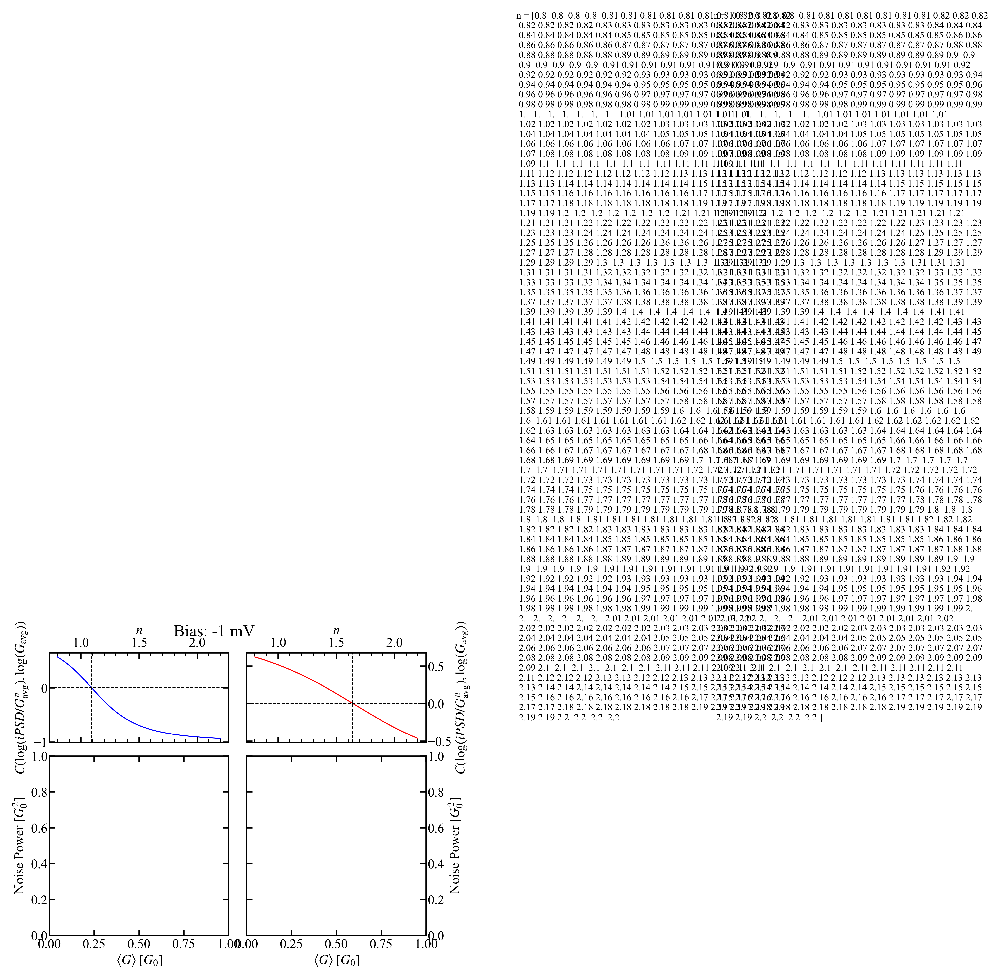

In [36]:
for bias_step in range(1, noise_stat_2.noise_power_pull.shape[1]):
    N = np.linspace(0.8, 2.2, num=1000)
    pull_corr = np.zeros_like(N)
    push_corr = np.zeros_like(N)

    for i, n in enumerate(N):

        pull_corr[i] = utils.calc_correlation(np.log10(noise_stat_2.noise_power_pull[:, bias_step]/noise_stat_2.avg_cond_on_step_pull[:, 0]**n),
                                                     np.log10(noise_stat_2.avg_cond_on_step_pull[:, bias_step]))
        push_corr[i] = utils.calc_correlation(np.log10(noise_stat_2.noise_power_push[:, bias_step]/noise_stat_2.avg_cond_on_step_push[:, 0]**n),
                                                     np.log10(noise_stat_2.avg_cond_on_step_push[:, bias_step]))

    fig = plt.figure(figsize=utils.cm2inch(10, 7.5), dpi=600)  # figsize: (width, height) in inches
    gs = gridspec.GridSpec(nrows=2, ncols=2, width_ratios=(1, 1), height_ratios=(1, 2),
                           figure=fig, left=0.15, right=0.95, top=0.9, bottom=0.1, wspace=0.1, hspace=0.1)
    
    fig.suptitle(f'Bias: {int(hold_trace.bias_steps[bias_step]*1000)} mV', fontsize=10)
    
    ax_corr_pull = fig.add_subplot(gs[0, 0])
    ax_corr_push = fig.add_subplot(gs[0, 1])
    ax_corrhist_pull = fig.add_subplot(gs[1, 0])
    ax_corrhist_push = fig.add_subplot(gs[1, 1], sharey=ax_corrhist_pull)

    ax_corr_pull.xaxis.set_label_position('top')
    ax_corr_pull.xaxis.tick_top()
    ax_corr_pull.xaxis.set_ticks_position('both')
    ax_corr_pull.yaxis.set_label_position('left')
    ax_corr_pull.yaxis.set_ticks_position('both')

    ax_corr_push.xaxis.set_label_position('top')
    ax_corr_push.xaxis.tick_top()
    ax_corr_push.xaxis.set_ticks_position('both')
    ax_corr_push.yaxis.set_label_position('right')
    ax_corr_push.yaxis.tick_right()
    ax_corr_push.yaxis.set_ticks_position('both')

    ax_corrhist_pull.xaxis.set_label_position('bottom')
    ax_corrhist_pull.xaxis.set_ticks_position('both')
    ax_corrhist_pull.yaxis.set_label_position('left')
    ax_corrhist_pull.yaxis.set_ticks_position('both')

    ax_corrhist_push.xaxis.set_label_position('bottom')
    ax_corrhist_push.xaxis.set_ticks_position('both')
    ax_corrhist_push.yaxis.set_label_position('right')
    ax_corrhist_push.yaxis.tick_right()
    ax_corrhist_push.yaxis.set_ticks_position('both')

    ax_corr_pull = noise_stat_2.plot_correlation(N, pull_corr, c='b', axis=ax_corr_pull, lw=0.6)
    ax_corr_push = noise_stat_2.plot_correlation(N, push_corr, c='r', axis=ax_corr_push, lw=0.6)

#     ax_corrhist_pull = noise_stat_2.plot_noise_power_2dhist(conductance_avgs=noise_stat_2.avg_cond_on_step_pull[:, bias_step],
#                                                             noise_power=noise_stat_2.noise_power_pull[:, bias_step],
#                                                             n=np.mean(N[abs(pull_corr) == min(abs(pull_corr))][0]),
#                                                             xrange=(1e-5, 0.1), yrange=(1e-13, 1e-5), num_bins=(20, 10),
#                                                             shift=-3.7, axis=ax_corrhist_pull)

#     ax_corrhist_push = noise_stat_2.plot_noise_power_2dhist(conductance_avgs=noise_stat_2.avg_cond_on_step_push[:, bias_step],
#                                                             noise_power=noise_stat_2.noise_power_push[:, bias_step],
#                                                             n=np.mean(N[abs(push_corr) == min(abs(push_corr))][0]),
#                                                             xrange=(1e-5, 0.1), yrange=(1e-13, 1e-5), num_bins=(20, 10),
#                                                             shift=-3.7, axis=ax_corrhist_push)

    ax_corrhist_pull.set_xlabel(r'$\langle G \rangle \; [G_0]$')
    ax_corrhist_push.set_xlabel(r'$\langle G \rangle \; [G_0]$')
    ax_corrhist_pull.set_ylabel(r'Noise Power $[G_0^2]$')
    ax_corrhist_push.set_ylabel(r'Noise Power $[G_0^2]$')

In [33]:
noise_stat_2.avg_cond_on_step_pull.shape

(6300, 3)

In [45]:
hold_trace.bias_steps

array([-0.0012    ,  0.04878779,  0.09880611], dtype=float32)

In [42]:
len(noise_stat_2.avg_cond_on_step_pull[noise_stat_2.avg_cond_on_step_pull[:, 1]<0, 1])

1693

In [ ]:
conductance_stat_pull = pd.read_csv(home_folder.joinpath("results/conductance_stats_pull_2.csv"), skiprows=[1])
conductance_stat_push = pd.read_csv(home_folder.joinpath("results/conductance_stats_push_2.csv"), skiprows=[1])

conductance_stat_pull.head()

conductance_stat_push.head()

conductance_filt_pull = (conductance_stat_pull[:][abs(np.log10(conductance_stat_pull['G_avgs_6'] / conductance_stat_pull['G_avgs_2'])) < np.log10(2)])[:][conductance_stat_pull['G_avgs_2'] > 1e-5]
conductance_filt_push = (conductance_stat_push[:][abs(np.log10(conductance_stat_push['G_avgs_6'] / conductance_stat_push['G_avgs_2'])) < np.log10(2)])[:][conductance_stat_push['G_avgs_2'] > 1e-5]

conductance_filt_pull = conductance_filt_pull
conductance_filt_push = conductance_filt_push[:][conductance_stat_push['G_avgs_2'] > 1e-5]

conductance_filt_pull.head()

conductance_filt_push.head()

filt_inds_pull = np.array(conductance_filt_pull.index)
filt_inds_push = np.array(conductance_filt_push.index)

print('Pull')
print('Number of all traces: ', conductance_stat_pull.count()['trace_index'])
print('Number of filtered traces: ', conductance_filt_pull.count()['trace_index'])
print('Yield: ', conductance_filt_pull.count()['trace_index']/conductance_stat_pull.count()['trace_index']*100, '%')
print('\n')
print('Push')
print('Number of all traces: ', conductance_stat_push.count()['trace_index'])
print('Number of filtered traces: ', conductance_filt_push.count()['trace_index'])
print('Yield: ', conductance_filt_push.count()['trace_index']/conductance_stat_push.count()['trace_index']*100, '%')

which = ('G_avgs_2', 'G_avgs_4')

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))

ax[0].scatter(conductance_filt_pull[which[0]], conductance_filt_pull[which[1]], alpha=0.2, c='b', edgecolor='None')
ax[0].set_xscale('log')
ax[0].set_yscale('log')
ax[0].set_xlim(1e-7, 1)
ax[0].set_ylim(1e-7, 1)
ax[0].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

ax[1].scatter(conductance_stat_pull[which[0]], conductance_stat_pull[which[1]], alpha=0.2, c='b', edgecolor='None')
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].set_xlim(1e-7, 1)
ax[1].set_ylim(1e-7, 1)
ax[1].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

which = ('G_avgs_2', 'G_avgs_5')

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))

ax[0].scatter(conductance_filt_push[which[0]], conductance_filt_push[which[1]], alpha=0.2, c='r', edgecolor='None')
ax[0].set_xscale('log')
ax[0].set_yscale('log')
ax[0].set_xlim(1e-7, 1)
ax[0].set_ylim(1e-7, 1)
ax[0].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

ax[1].scatter(conductance_stat_push[which[0]], conductance_stat_push[which[1]], alpha=0.2, c='r', edgecolor='None')
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].set_xlim(1e-7, 1)
ax[1].set_ylim(1e-7, 1)
ax[1].plot(np.logspace(-7, 0, num=10, base=10), np.logspace(-7, 0, num=10, base=10), c='k', ls='--')

noise_stat_pull = pd.read_csv(home_folder.joinpath("results/noise_stats_pull_1.csv"), skiprows=[1])
noise_stat_push = pd.read_csv(home_folder.joinpath("results/noise_stats_push_1.csv"), skiprows=[1])

noise_stat_pull.head()

noise_stat_pull['noise_power_1'][filt_inds_pull]

def plot_correlation(n, correlation, axis=None, **kwargs):

    if axis is None:
        fig, ax = plt.subplots(1, figsize=utils.cm2inch(6, 4), dpi=600)
    else:
        ax = axis
    ax.plot(n, correlation, **kwargs)
    ax.set_xlabel(r'$n$')
    ax.set_ylabel(r'$C(\log(iPSD/G_{\mathrm{avg}}^{n}), \log(G_{\mathrm{avg}}))$')
    ax.axhline(y=0, xmin=0, xmax=1, ls='--', lw=0.5, c='k')
    ax.axvline(x=n[abs(correlation) == min(abs(correlation))][0], ymin=0, ymax=1,
               ls='--', lw=0.5, c='k')
    ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.1))
    ax.text(x=0.15, y=0.15, s=f"n = {np.round(n[abs(correlation) == min(abs(correlation))][0], 2)}",
            transform=ax.transAxes, fontsize='xx-small', ha='left', va='bottom')

    return ax

def plot_noise_power_2dhist(conductance_avgs: np.ndarray, noise_power: np.ndarray, n: float,
                            xrange: Optional[Tuple[float, float]] = (1e-5, 0.1),
                            yrange: Optional[Tuple[float, float]] = (1e-12, 1e-5),
                            num_bins: Optional[Tuple[int, int]] = (10, 10),
                            shift: Optional[float] = 0, axis=None, **kwargs):

    num_of_decs_x = np.log10(xrange[1]) - np.log10(xrange[0])
    num_of_decs_y = np.log10(yrange[1]) - np.log10(yrange[0])

    xbins = np.logspace(np.log10(xrange[0]), np.log10(xrange[1]), num=int(num_bins[0] * num_of_decs_x))
    ybins = np.logspace(np.log10(yrange[0]), np.log10(yrange[1]), num=int(num_bins[0] * num_of_decs_y))

    h, xedges, yedges = np.histogram2d(conductance_avgs.flatten(), noise_power.flatten(), bins=[xbins, ybins])
    x_mesh, y_mesh = np.meshgrid(xedges, yedges)

    if axis is None:
        fig, ax = plt.subplots(1, figsize=utils.cm2inch(4, 4), dpi=600)
    else:
        ax = axis

    ax.set_xscale('log')
    ax.set_yscale('log')

    ax.set_xlim(xrange[0], xrange[1])
    ax.set_ylim(yrange[0], yrange[1])

    ax.xaxis.set_major_locator(ticker.LogLocator(base=10.0, subs=(1.0,), numticks=9))
    ax.xaxis.set_minor_locator(ticker.LogLocator(base=10.0, subs=np.arange(0, 1, 0.1), numticks=9))
    ax.yaxis.set_major_locator(ticker.LogLocator(base=10.0, subs=(1.0,), numticks=9))

    ax.set_xlabel(r'$\langle G \rangle [G_0]$')

    ax.plot(xbins, 10 ** (n * np.log10(xbins) + shift), lw=0.5, ls='--', c='k')

    ax.text(x=0.85, y=0.15, s=f"n = {np.round(n, 2)}",
            transform=ax.transAxes, fontsize='xx-small', ha='right', va='bottom')

    im = ax.pcolormesh(x_mesh, y_mesh, h.T, **kwargs)

    return ax

## No filter

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    pull_corr[i] = utils.calc_correlation(np.log10(noise_stat_pull['noise_power_1']/ \
                                                   noise_stat_pull['avg_cond_on_step_1']**n),
                                          np.log10(noise_stat_pull['avg_cond_on_step_1']))
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push['noise_power_1']/ \
                                                   noise_stat_push['avg_cond_on_step_1']**n),
                                          np.log10(noise_stat_push['avg_cond_on_step_1']))

plot_correlation(n = N, correlation = pull_corr, lw=0.5, c='blue')
plot_correlation(n = N, correlation = push_corr, lw=0.5, c='red')

plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_pull['avg_cond_on_step_1']),
                        noise_power=np.array(noise_stat_pull['conductance_noise_1']),
                        n = np.mean((N[pull_corr<0][0], N[pull_corr>0][-1])),
                        xrange=(1e-6, 0.1),
                        yrange=(1e-4, 1),
                        num_bins=(10, 10),
                        shift=-4,
                        cmap=hist_1.cmap_geo32)

plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_push['avg_cond_on_step_1']),
                        noise_power=np.array(noise_stat_push['conductance_noise_1']),
                        n = np.mean((N[pull_corr<0][0], N[push_corr>0][-1])),
                        xrange=(1e-6, 0.1),
                        yrange=(1e-4, 1),
                        num_bins=(10, 10),
                        shift=-4,
                        cmap=hist_1.cmap_geo32)

## Filter

N = np.linspace(0.8, 2.2, num=1000)
pull_corr = np.zeros_like(N)
push_corr = np.zeros_like(N)
for i, n in enumerate(N):
    pull_corr[i] = utils.calc_correlation(np.log10(noise_stat_pull['noise_power_1'][filt_inds_pull]/ \
                                                   noise_stat_pull['avg_cond_on_step_1'][filt_inds_pull]**n),
                                          np.log10(noise_stat_pull['avg_cond_on_step_1'][filt_inds_pull]))
    push_corr[i] = utils.calc_correlation(np.log10(noise_stat_push['noise_power_1'][filt_inds_push]/ \
                                                   noise_stat_push['avg_cond_on_step_1'][filt_inds_push]**n),
                                          np.log10(noise_stat_push['avg_cond_on_step_1'][filt_inds_push]))

plot_correlation(n = N, correlation = pull_corr, lw=0.5, c='blue')
plot_correlation(n = N, correlation = push_corr, lw=0.5, c='red')

plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_pull['avg_cond_on_step_1'][filt_inds_pull]),
                        noise_power=np.array(noise_stat_pull['conductance_noise_1'][filt_inds_pull]),
                        n = np.mean((N[pull_corr<0][0], N[pull_corr>0][-1])),
                        xrange=(1e-4, 0.01),
                        yrange=(1e-3, 1),
                        num_bins=(20, 20),
                        shift=-4,
                        cmap=hist_1.cmap_geo32)

plot_noise_power_2dhist(conductance_avgs=np.array(noise_stat_push['avg_cond_on_step_1'][filt_inds_push]),
                        noise_power=np.array(noise_stat_push['conductance_noise_1'][filt_inds_push]),
                        n = np.mean((N[pull_corr<0][0], N[push_corr>0][-1])),
                        xrange=(1e-4, 0.01),
                        yrange=(1e-3, 1),
                        num_bins=(20, 20),
                        shift=-4,
                        cmap=hist_1.cmap_geo32)